In [1]:
import sys, re, os
import numpy as np
import pandas as pd

In [2]:
# Change the work directory to the parent
try:
    if chdir:
        pass
except:
    current_dir = os.getcwd()
    os.chdir(current_dir +"/..")
    os.path.abspath(os.curdir)

In [3]:
chdir = True

In [4]:
import matplotlib.pyplot as plt
%matplotlib inline

plt.rc('font', family='serif')
plt.rcParams.update({'font.size': 11})

plt.rcParams['figure.dpi'] = 200
plt.rcParams['savefig.dpi'] = 300

In [5]:
import itertools
marker = itertools.cycle(('x',',', '+', '.', 'o', '*'))
cycol = itertools.cycle('bgrcmk')

In [6]:
# Some helper functions
def get_stat(stat_name, source="general/fastclick-varied-cbr-rates.csv", index=1):
    stat = []
    with open(source) as file:
        for line in file:
            if re.search(stat_name, line):
                stat.append(line.strip().split(',')[index])
    
    return list(map(lambda x:float(x), stat[:-1]))

def plot_stat(stat_name, ax, source, index=1):
    stat = get_stat(stat_name, source, index)
    ax.plot(stat)
    ax.grid(True)
    ax.set_title(stat_name)

def plot_stats(stat_names, source="fastclick-varied-cbr-rates.csv", index=1):
    i = 1
    fig, ax = plt.subplots(len(stat_names),2)
    for s in stat_names:
        ax = plt.subplot(len(stat_names),1, i)
        plot_stat(s, ax, source, index)
        i+=1
    fig.tight_layout()

### Service chain configuration:

In [7]:
from IPython.display import IFrame
IFrame("../assets/dag-2.pdf", width=600, height=420)

In [9]:
# Metadata for specific SFC configurations
exp_ls = "exp4"
exp_rs = "exp-4-1-1"
vnfs = ["flow_tracker.csv", "nf_router.csv", "ndpi_stats.csv", "payload_scan.csv", "bridge.csv"]

In [10]:
def parse_seq(exp_type, exp_num, file, index=5):
    "Parse sequential data, specialized for the TX/RX/Latency experiments"
    tmp = []
    
    if file.startswith("latency.csv"):
        with open(os.path.join("..\\dag-2\\data",exp_type, exp_num, file)) as f:
            lines = f.readlines()[4:] if exp_type == "load_stimulus" else f.readlines()
            for line in lines:
                tmp.append(float(line.strip())/1000)
    else:
        with open(os.path.join("..\\dag-2\\data",exp_type, exp_num, file)) as f:
            next(f)
            for l in f:
                tmp.append(float(l.strip().split(",")[index]))
                
    return tmp

In [11]:
def parse_reg(exp_type, exp_num, file, stat_name, index=1):
    "Parse the Perf data"
    stat = []
    with open(os.path.join("..\\dag-2\\data", exp_type, exp_num, file)) as file:
        for line in file:
            if re.search(stat_name, line):
                stat.append(line.strip().split(',')[index])
    
    return list(map(lambda x:float(x), stat[:-1]))

# Make dataset

In [12]:
features = ["instructions", "branches,", "branch-misses,", "branch-load-misses,", "cache-misses", \
            "cache-references", ",cycles,", "L1-dcache-load-misses", "L1-dcache-loads", "LLC-load-misses", \
            "LLC-stores", "LLC-loads",]

In [13]:
def make_df():
    tmp = []
    dic = dict()
    
    tx_stats = parse_seq("load_stimulus", exp_ls, "tx_stats.csv")
    rx_stats = parse_seq("load_stimulus", exp_ls, "rx_stats.csv")
    
    latency = parse_seq("load_stimulus", exp_ls, "latency.csv")
    #normalized_latency = []
    #for i in range(0, len(latency)):
        #if i % 2:
            #normalized_latency.append(latency[i])
    
    seq_length = min([len(parse_reg("load_stimulus", exp_ls, "bridge.csv", "instructions", 1)), \
                          len(tx_stats), \
                          len(rx_stats), \
                          len(latency)])
    dic["input_rate"] = tx_stats[:seq_length]
    dic["output_rate"] = rx_stats[:seq_length]
    dic["latency"] = latency[:seq_length]
    
    for f in features:
        for v in vnfs:
            tmp = parse_reg("load_stimulus", exp_ls, v, f, 1)
            
            dic[v.split(".")[0]+"_"+f.replace(",","")] = tmp[:seq_length]
            
    return pd.DataFrame(dic)

In [14]:
df = make_df()
df

,input_rate,output_rate,latency,flow_tracker_instructions,nf_router_instructions,ndpi_stats_instructions,payload_scan_instructions,bridge_instructions,flow_tracker_branches,nf_router_branches,...,flow_tracker_LLC-stores,nf_router_LLC-stores,ndpi_stats_LLC-stores,payload_scan_LLC-stores,bridge_LLC-stores,flow_tracker_LLC-loads,nf_router_LLC-loads,ndpi_stats_LLC-loads,payload_scan_LLC-loads,bridge_LLC-loads
0,183.067293,181.258049,10.007,9.896042e+09,1.089906e+10,1.107882e+10,1.119543e+10,1.098788e+10,1.939587e+09,2.154286e+09,...,394520.0,1130807.0,382139.0,360586.0,821930.0,1003679.0,1592934.0,1177907.0,950287.0,1764503.0
1,517.158510,528.306740,10.391,1.021195e+10,1.082649e+10,1.117814e+10,1.110063e+10,1.090886e+10,2.001846e+09,2.143397e+09,...,430089.0,1168097.0,416560.0,399988.0,839158.0,1024098.0,1587795.0,1226236.0,975848.0,1720558.0
2,528.278322,528.313224,5.716,1.030178e+10,1.092927e+10,1.121019e+10,1.122444e+10,1.101331e+10,2.015109e+09,2.159012e+09,...,433469.0,1162601.0,425497.0,396860.0,844663.0,1032534.0,1555721.0,1256903.0,974994.0,1704754.0
3,528.206471,528.210856,12.902,1.038195e+10,9.755068e+09,1.117794e+10,1.110820e+10,1.092893e+10,2.004713e+09,1.953220e+09,...,435291.0,1190081.0,424515.0,401152.0,857399.0,1045577.0,1593125.0,1296723.0,992561.0,1760230.0
4,528.333709,528.312501,11.993,1.038443e+10,1.085569e+10,1.119319e+10,1.131854e+10,1.093481e+10,2.005469e+09,2.148033e+09,...,440899.0,1198321.0,424336.0,401754.0,868527.0,1045295.0,1613321.0,1267436.0,991068.0,1764987.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202,528.252756,528.269218,232.844,1.021453e+10,1.101294e+10,1.101035e+10,1.104667e+10,1.110352e+10,2.002689e+09,2.170830e+09,...,436413.0,1200027.0,413214.0,399784.0,865638.0,1050813.0,1606448.0,1269308.0,995603.0,1783954.0
203,528.266698,528.272809,244.724,1.031081e+10,1.101915e+10,1.111227e+10,1.104379e+10,1.110860e+10,2.016318e+09,2.171428e+09,...,429617.0,1196220.0,419081.0,389956.0,861090.0,1047128.0,1612449.0,1267081.0,987937.0,1799948.0
204,528.208419,528.204848,224.560,1.015995e+10,1.079219e+10,1.094596e+10,1.107104e+10,1.085032e+10,1.993870e+09,2.138055e+09,...,433667.0,1201293.0,418492.0,400500.0,854764.0,1054813.0,1593108.0,1250692.0,998613.0,1730957.0
205,528.361576,528.345335,221.044,1.031021e+10,1.093215e+10,1.111190e+10,1.122953e+10,1.036526e+10,2.016289e+09,2.158413e+09,...,432943.0,1160005.0,418593.0,394458.0,833850.0,1030723.0,1582698.0,1280957.0,975842.0,1803041.0


In [15]:
abs_path = os.path.join("..\\dag-2\\datasets", "load_stimulus_"+ exp_ls +".csv")
df.to_csv(abs_path, sep=',')

## Load stimulus experiments
### High-level KPIs: 

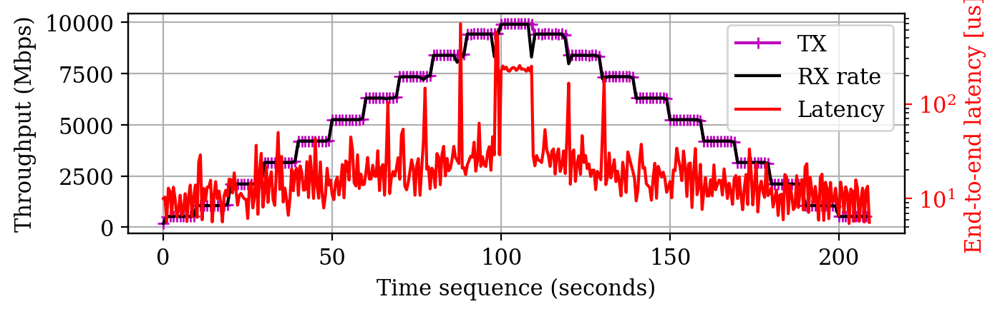

In [20]:
fig, ax = plt.subplots(figsize = (7,2))
ax.grid(True)
ax.set_xlabel("Time sequence (seconds)")
ax.set_ylabel("Throughput (Mbps)")

ax2 = ax.twinx()
ax2.tick_params(axis='y', colors='red')
ax2.set_ylabel("End-to-end latency [us]", color="red")

l = ax.plot(parse_seq("load_stimulus", exp_ls, "tx_stats.csv"), marker=next(marker), color=next(cycol), label="TX")
l1 = ax.plot(parse_seq("load_stimulus", exp_ls, "rx_stats.csv"), color=next(cycol), label="RX rate")
lat = parse_seq("load_stimulus", exp_ls, "latency.csv")
ax2.set_yscale("log")
l2 = ax2.plot(0.5*np.arange(0, len(lat)), lat, color="red", label="Latency")

lns = l+l1+l2
labs = [l.get_label() for l in lns]
plt.legend(lns, labs)

### Instruction rate: instructions per second and per clock cycle

In [21]:
def init_plt(ax2_title):
    fig, ax = plt.subplots(figsize = (7,2))
    ax.grid(True)
    ax.set_xlabel("Time sequence (seconds)")
    ax.set_ylabel("Throughput (Mbps)")

    ax2 = ax.twinx()
    ax2.tick_params(axis='y', colors='red')
    ax2.set_ylabel(ax2_title, color="red")
    
    return fig, ax, ax2

In [22]:
def plot_feature(feature, label, index=1):
    fig, ax, ax2 = init_plt(label)
    tx = parse_seq("load_stimulus", exp_ls, "tx_stats.csv")
    lns = ax.plot(tx, marker=next(marker), color=next(cycol), label="TX")

    for v in vnfs:
        data = parse_reg("load_stimulus", exp_ls, v, feature, index)
        lns += ax2.plot(data, color=next(cycol), label=v.split(".")[0])

    labs = [l.get_label() for l in lns]
    plt.legend(lns, labs, loc=1, bbox_to_anchor=(1, 1.2), ncol=6, prop={'size': 7})

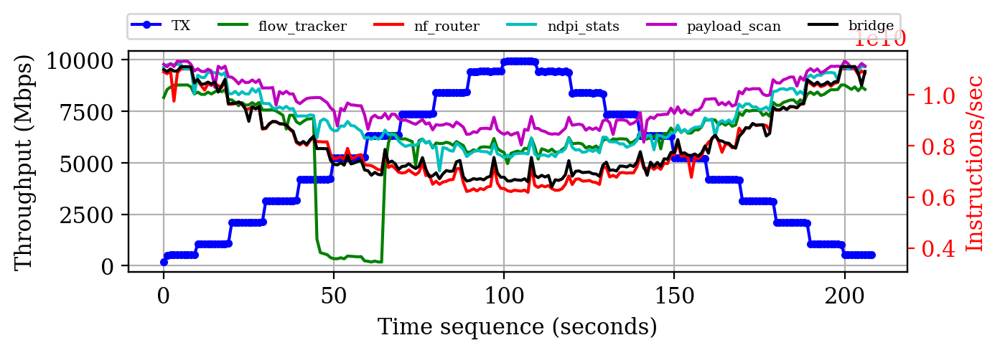

In [23]:
plot_feature("instructions", "Instructions/sec")

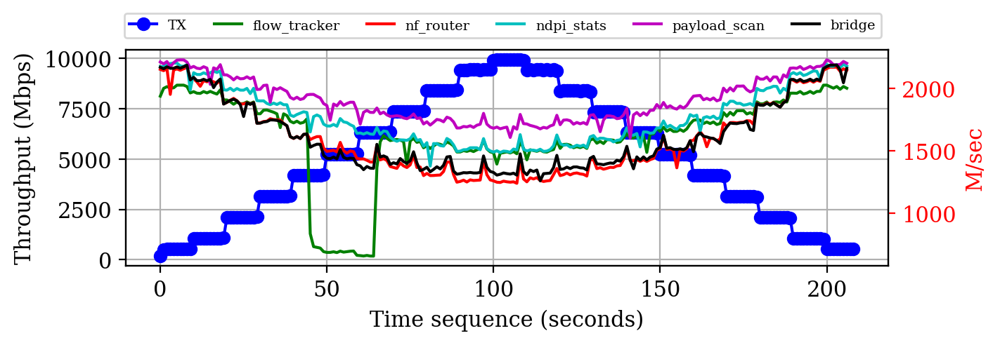

In [24]:
plot_feature("branches,", "M/sec", 7)

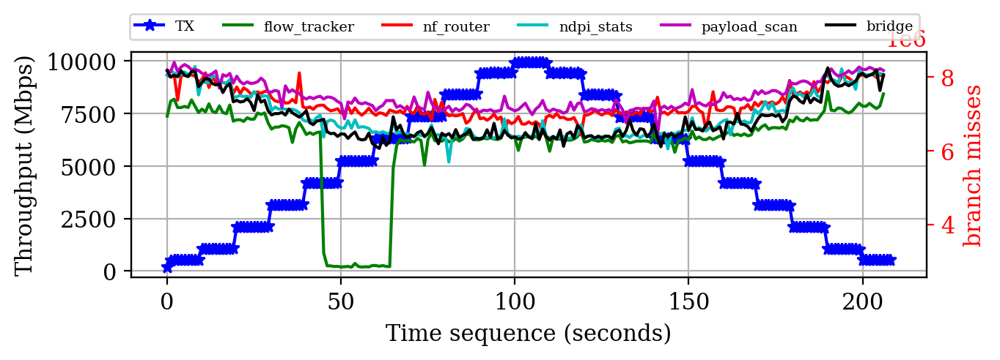

In [25]:
plot_feature("branch-misses,", "branch misses")

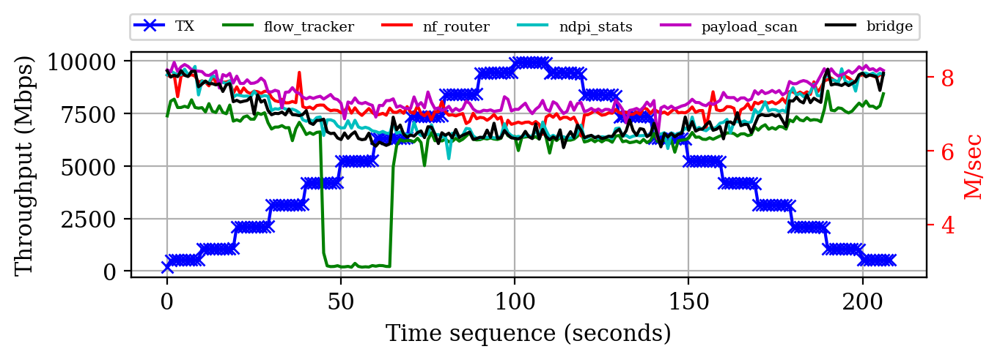

In [26]:
plot_feature("branch-load-misses,", "M/sec", 7)

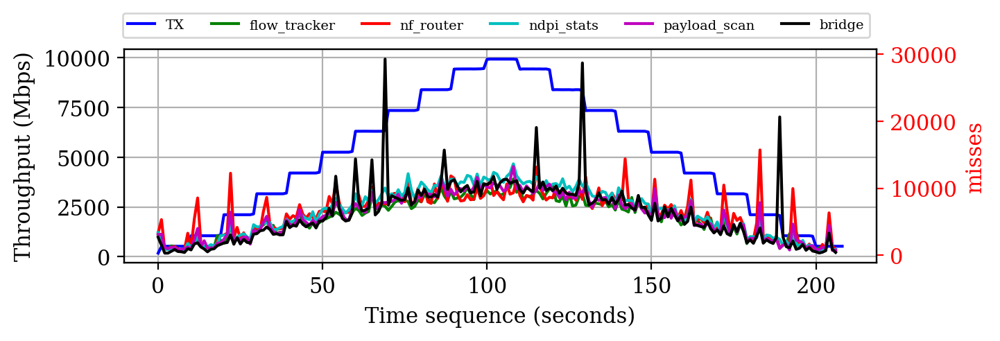

In [27]:
plot_feature("cache-misses", "misses", )

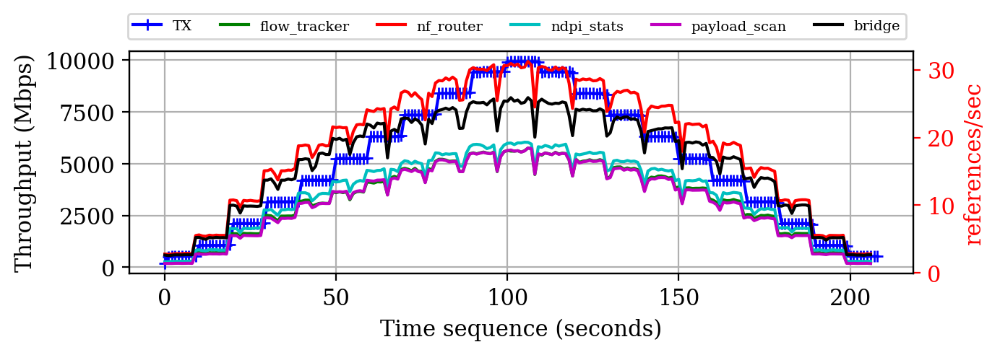

In [28]:
plot_feature("cache-references", "references/sec", 7)

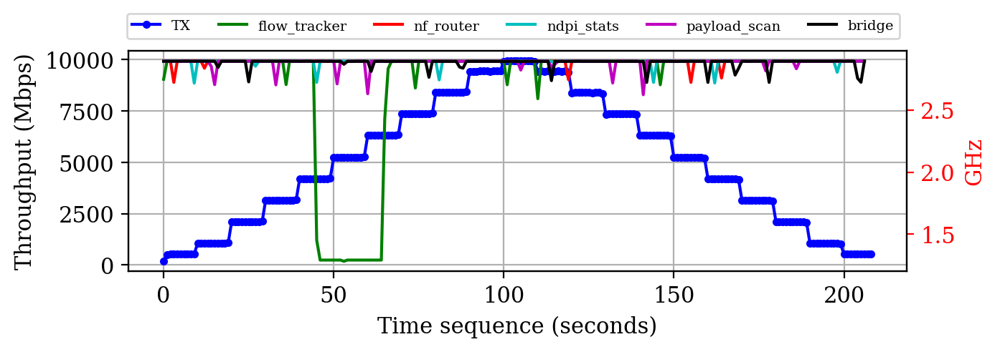

In [29]:
plot_feature(",cycles,", "GHz", 7)

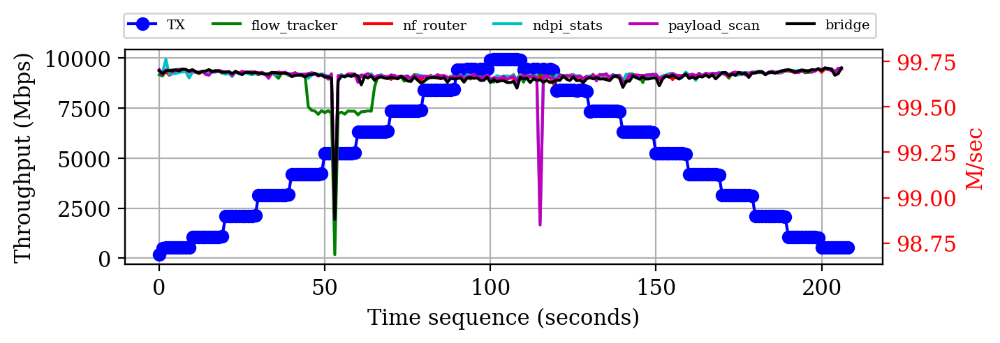

In [30]:
plot_feature("bus-cycles", "M/sec", 7)

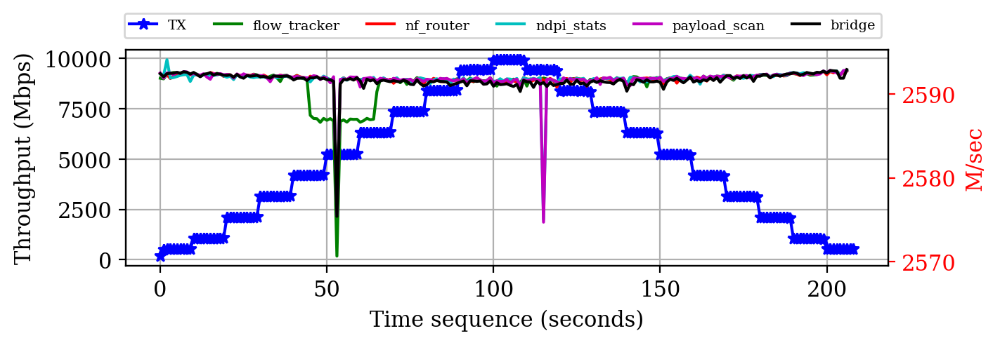

In [31]:
plot_feature("ref-cycles", "M/sec", 7)

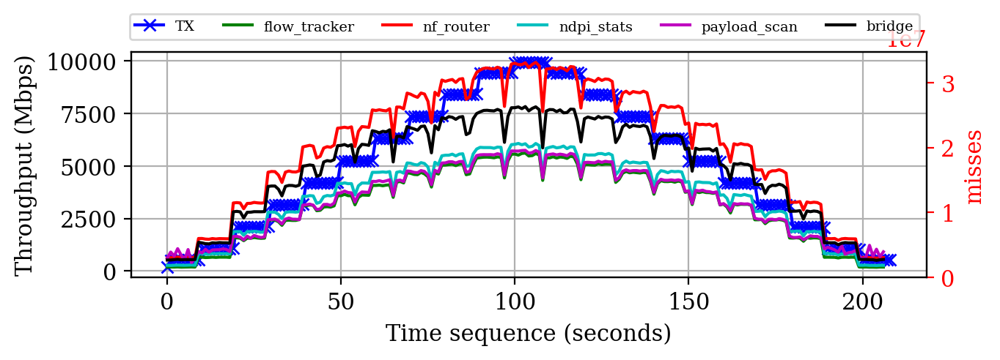

In [32]:
plot_feature("L1-dcache-load-misses", "misses")

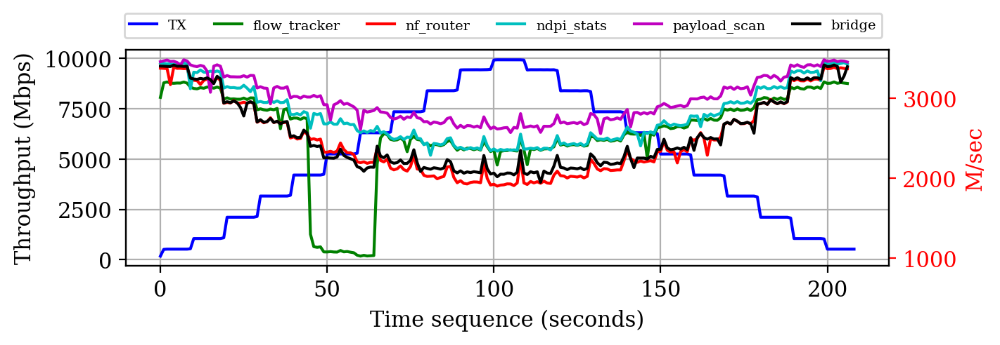

In [33]:
plot_feature("L1-dcache-loads", "M/sec", 7)

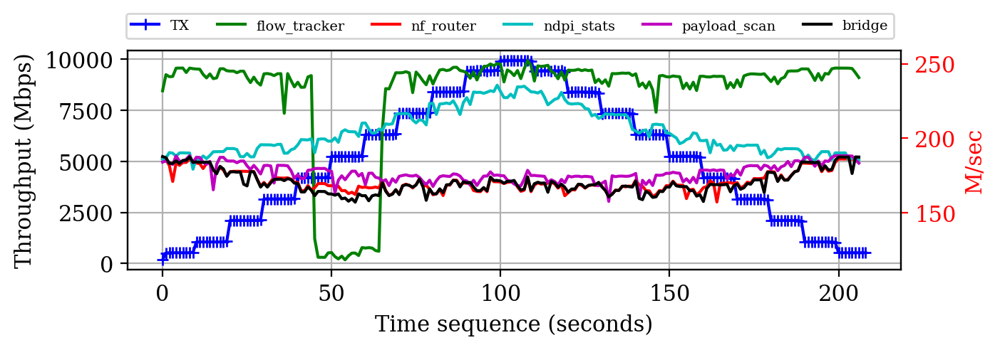

In [34]:
plot_feature("L1-dcache-stores", "M/sec", 7)

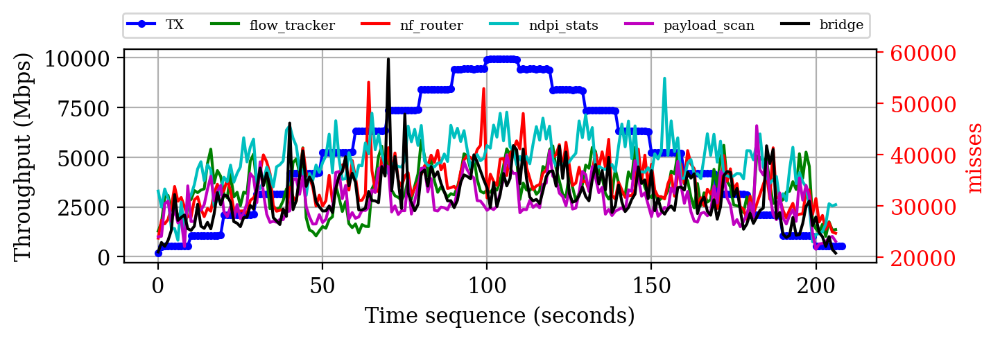

In [35]:
plot_feature("L1-icache-load-misses", "misses", )

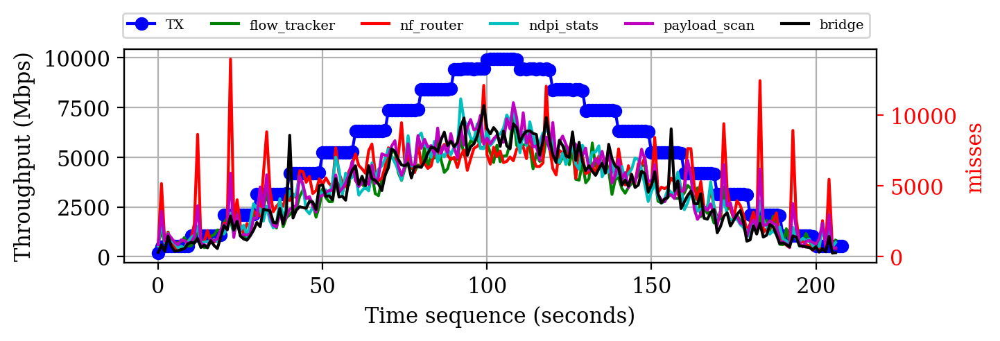

In [36]:
plot_feature("LLC-load-misses", "misses", )

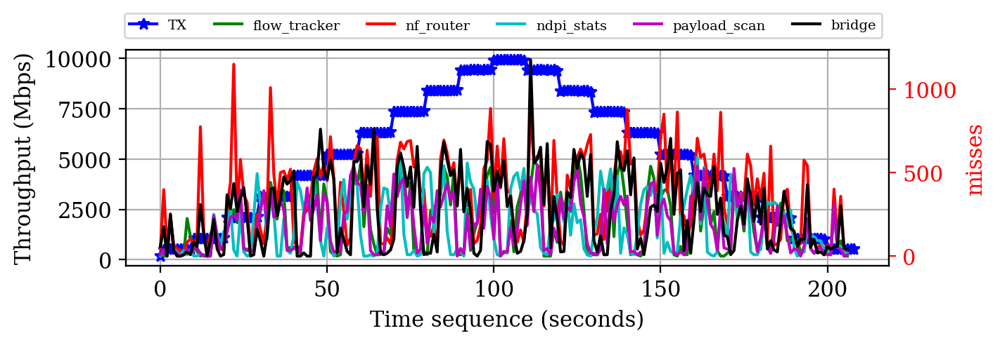

In [37]:
plot_feature("LLC-store-misses", "misses", )

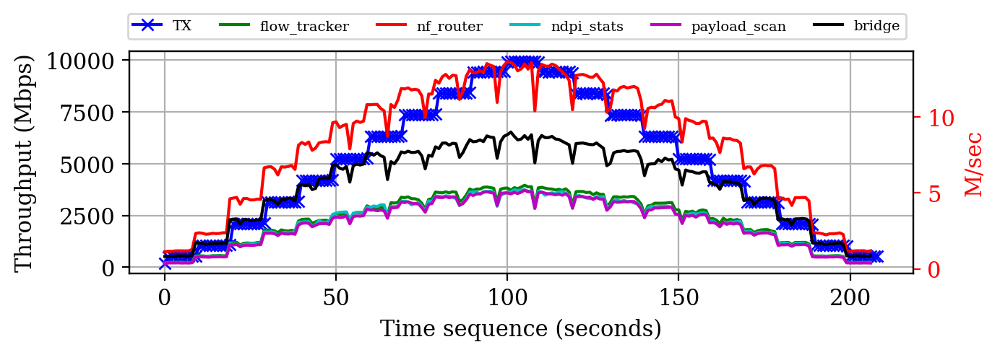

In [38]:
plot_feature("LLC-stores", "M/sec", 7)

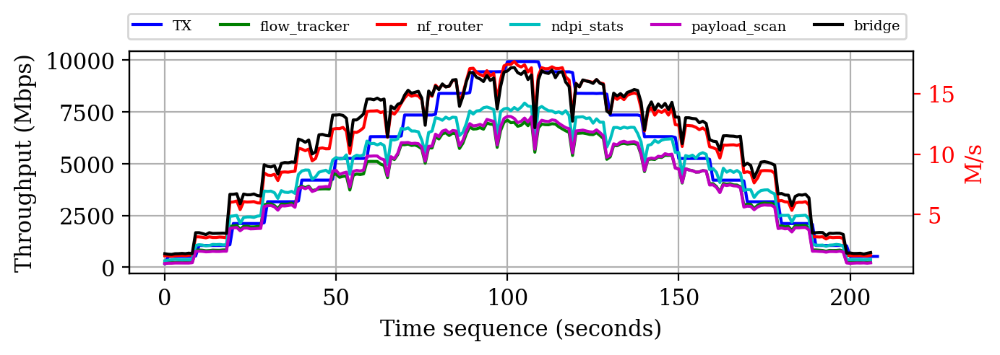

In [39]:
plot_feature("LLC-loads", "M/s", 7)

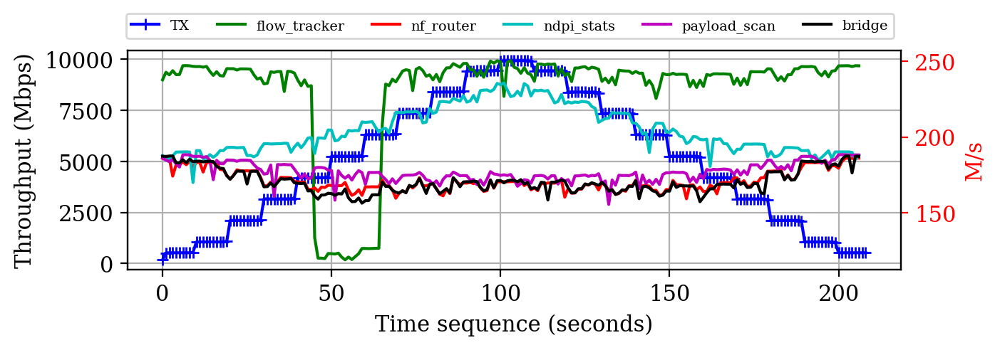

In [40]:
plot_feature("dTLB-stores", "M/s", 7)

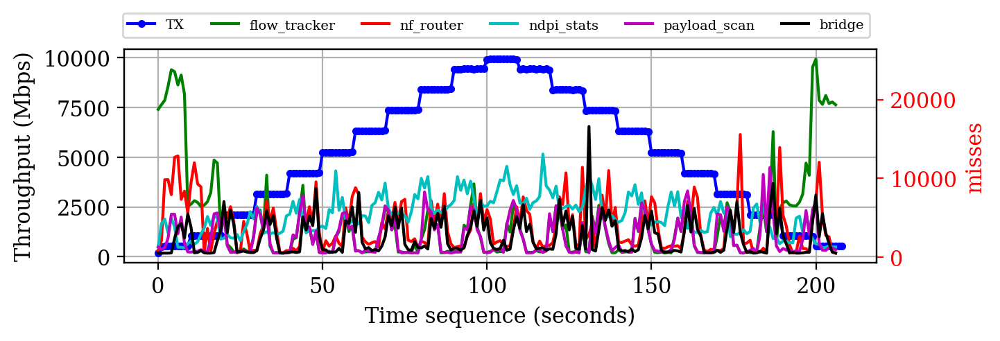

In [41]:
plot_feature("dTLB-load-misses", "misses",)

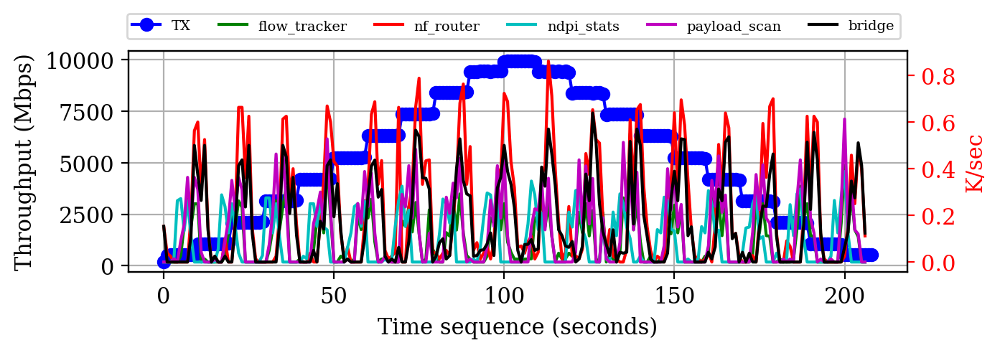

In [42]:
plot_feature("dTLB-store-misses", "K/sec", 7)

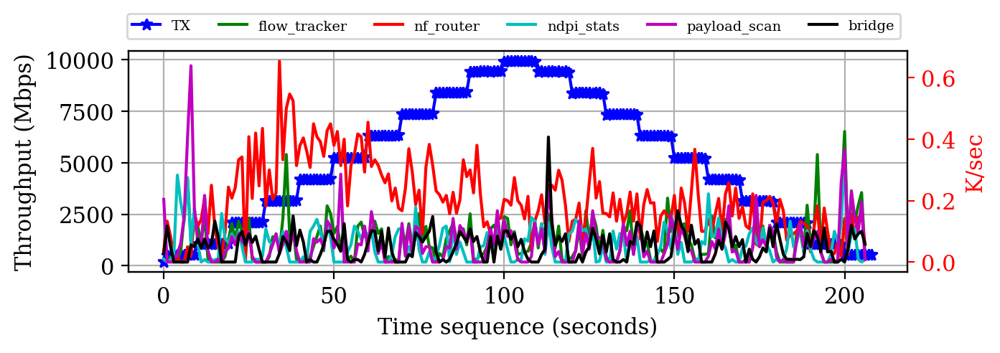

In [43]:
plot_feature("iTLB-loads", "K/sec", 7)

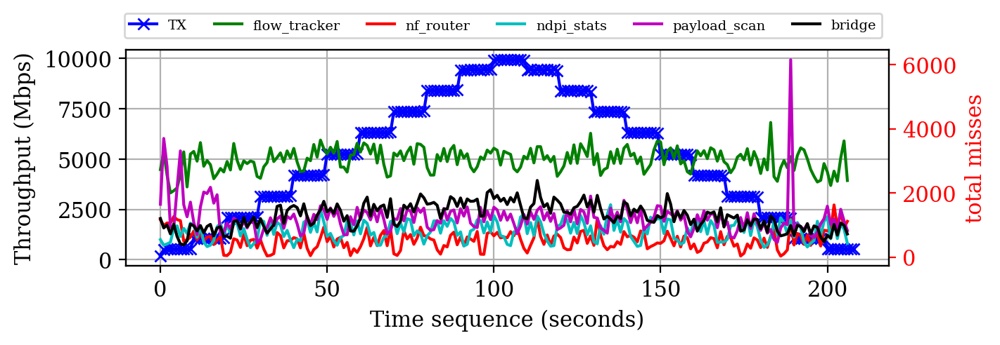

In [44]:
plot_feature("iTLB-load-misses", "total misses",)

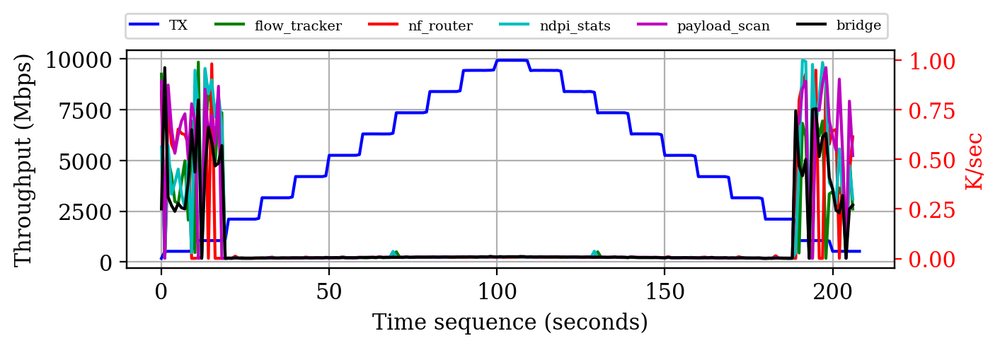

In [45]:
plot_feature("node-loads", "K/sec", 7)

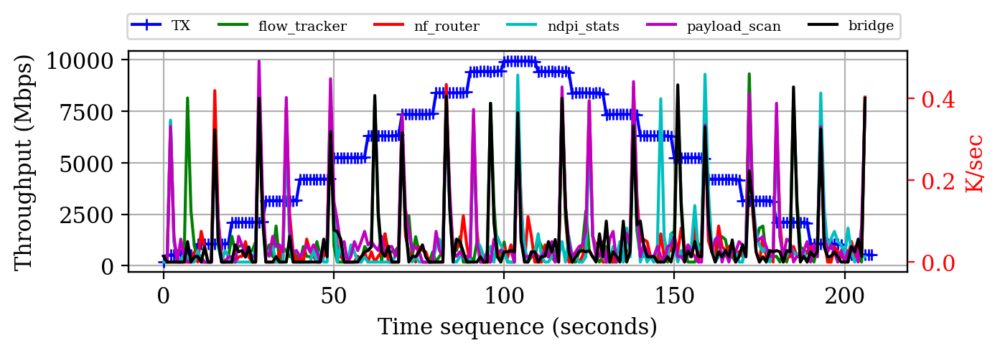

In [46]:
plot_feature("node-store-misses", "K/sec", 7)

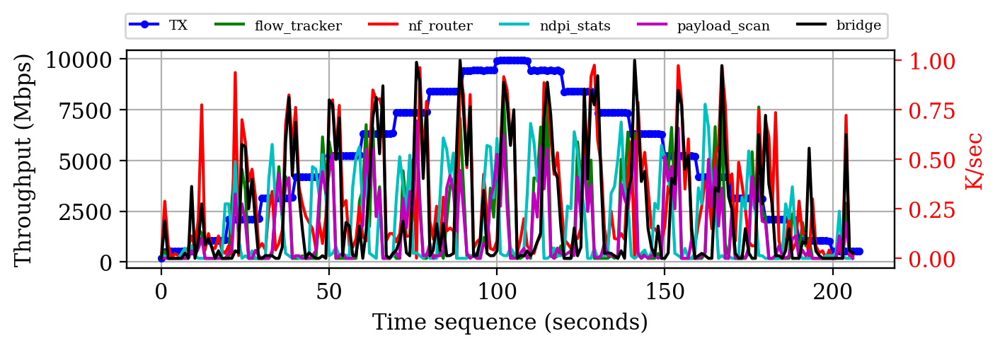

In [47]:
plot_feature("node-stores", "K/sec", 7)

## Resource stimulus experiments

### Case 1: stress-testing the Flow_tracker

In [48]:
from IPython.display import IFrame
IFrame("../assets/case3.pdf", width=600, height=420)

In [50]:
exp_rs = "exp-3-3-4"

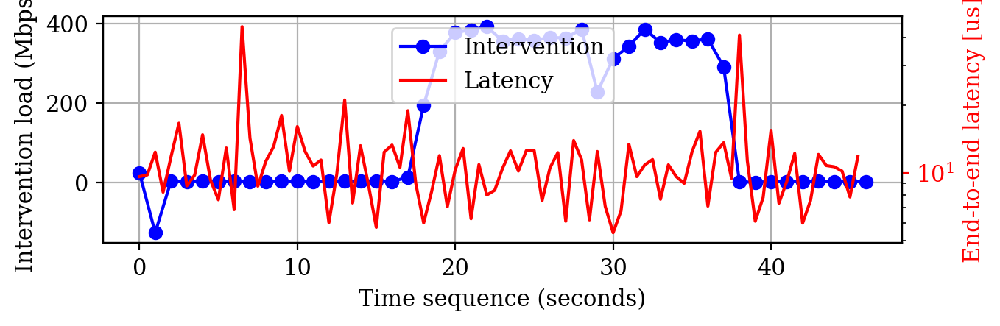

In [51]:
fig, ax = plt.subplots(figsize = (7,2))
ax.grid(True)
ax.set_xlabel("Time sequence (seconds)")
ax.set_ylabel("Intervention load (Mbps)")

ax2 = ax.twinx()
ax2.tick_params(axis='y', colors='red')
ax2.set_ylabel("End-to-end latency [us]", color="red")

tx = np.asarray(parse_seq("resource_stimulus", exp_rs, "tx_stats.csv"))
rx = np.asarray(parse_seq("resource_stimulus", exp_rs, "rx_stats.csv"))

diff = tx-rx

l = ax.plot(diff, marker=next(marker), color=next(cycol), label="Intervention")
lat = parse_seq("resource_stimulus", exp_rs, "latency.csv")
ax2.set_yscale("log")
l2 = ax2.plot(0.5*np.arange(0, len(lat)), lat, color="red", label="Latency")

lns = l+l2
labs = [l.get_label() for l in lns]
plt.legend(lns, labs)

In [52]:
def plot_feature_rs(feature, label, index=1):
    fig, ax, ax2 = init_plt(label)
    tx = np.asarray(parse_seq("resource_stimulus", exp_rs, "tx_stats.csv"))
    rx = np.asarray(parse_seq("resource_stimulus", exp_rs, "rx_stats.csv"))

    lns = ax.plot(tx-rx, marker=next(marker), color=next(cycol), label="Intervention")

    for v in vnfs:
        data = parse_reg("resource_stimulus", exp_rs, v, feature, index)
        lns += ax2.plot(data, color=next(cycol), label=v.split(".")[0])

    labs = [l.get_label() for l in lns]
    plt.legend(lns, labs, loc=1, bbox_to_anchor=(1, 1.2), ncol=6, prop={'size': 7})

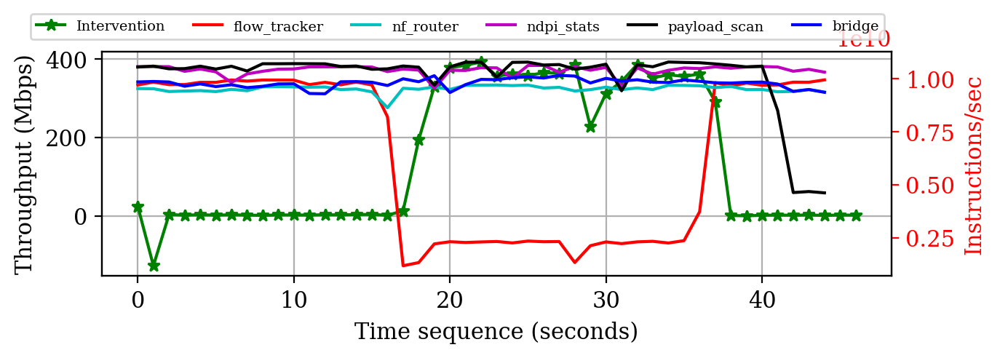

In [53]:
plot_feature_rs("instructions,", "Instructions/sec")

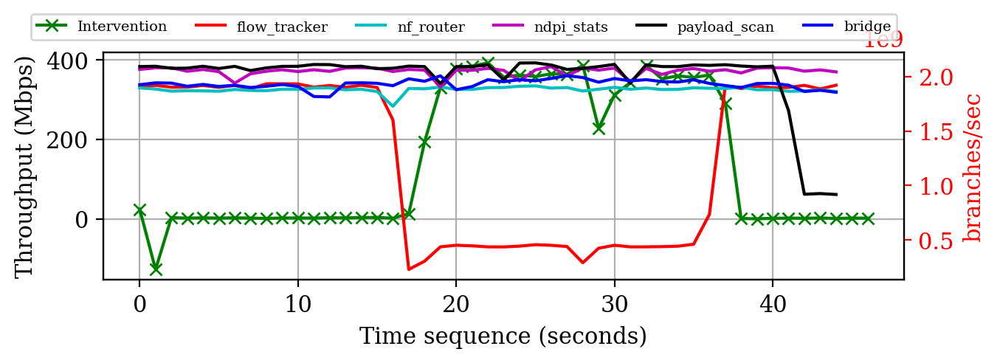

In [54]:
plot_feature_rs("branches,", "branches/sec",)

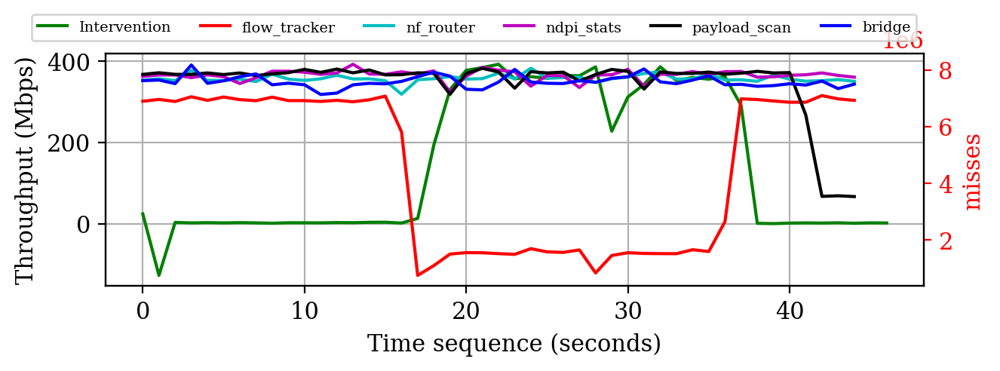

In [55]:
plot_feature_rs("branch-misses", "misses")

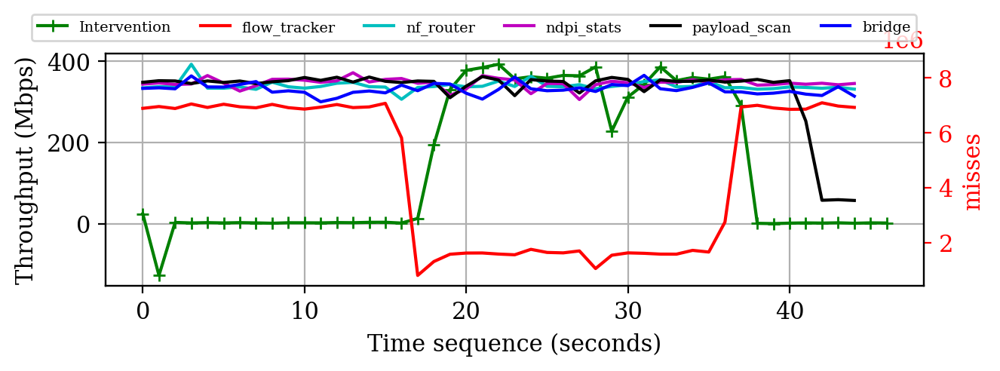

In [56]:
plot_feature_rs("branch-load-misses", "misses")

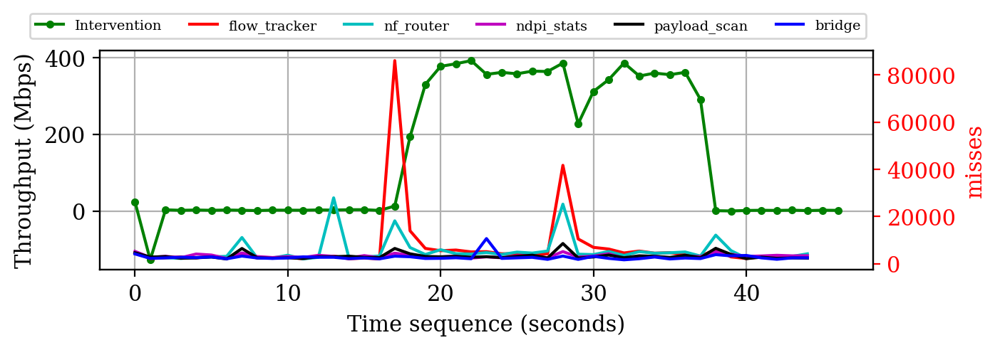

In [57]:
plot_feature_rs("cache-misses", "misses")

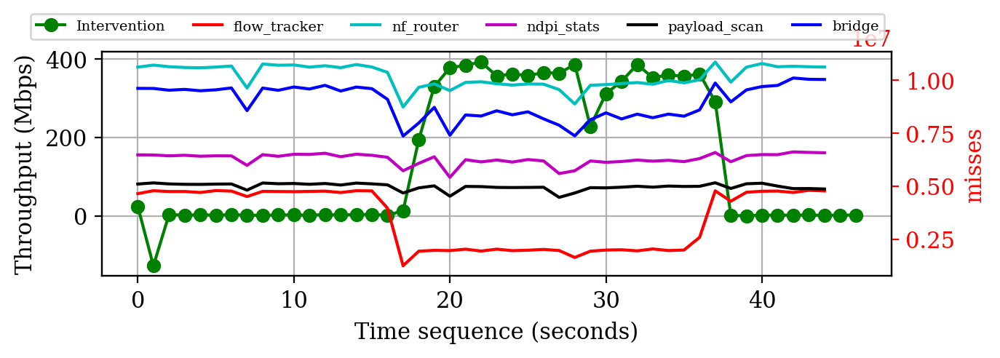

In [58]:
plot_feature_rs("cache-references", "misses")

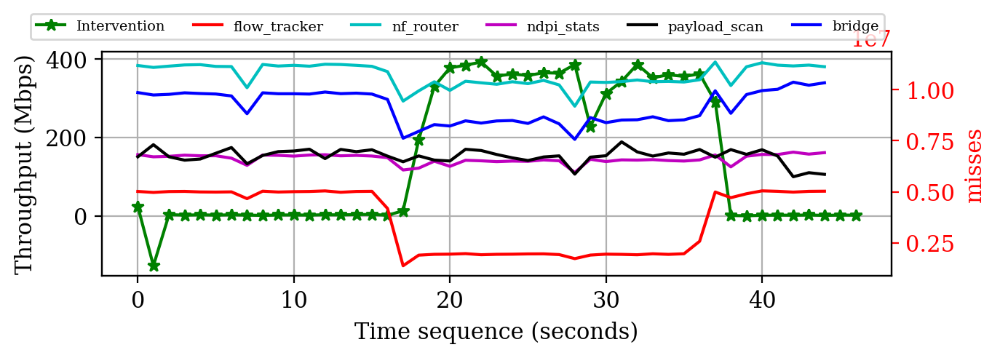

In [59]:
plot_feature_rs("L1-dcache-load-misses", "misses", )

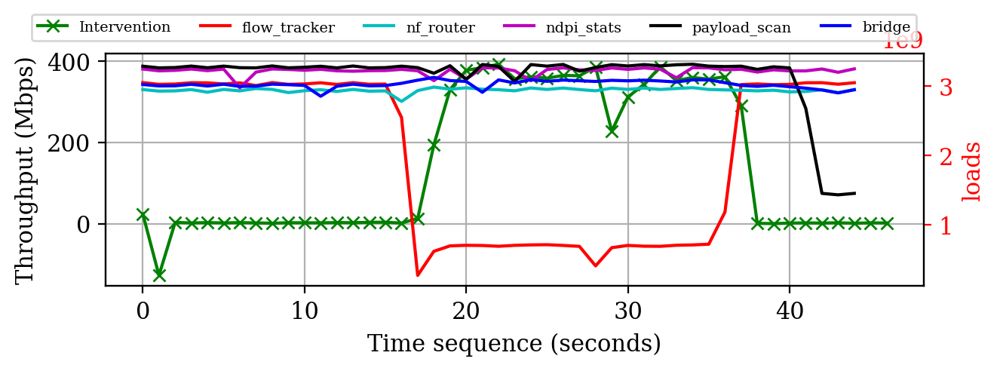

In [60]:
plot_feature_rs("L1-dcache-loads", "loads", )

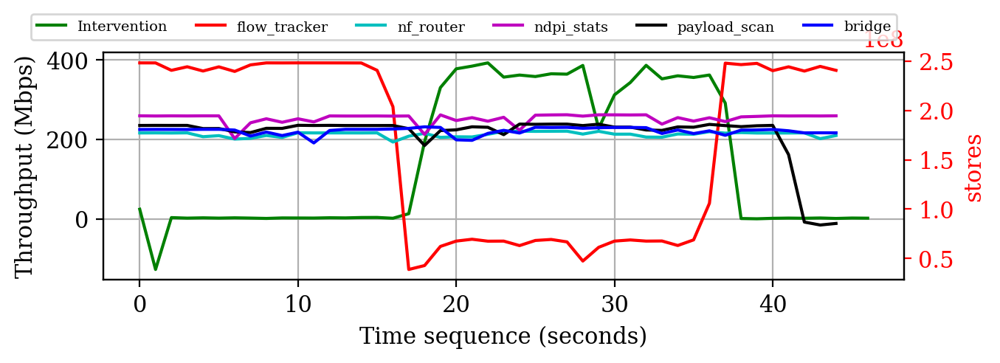

In [61]:
plot_feature_rs("L1-dcache-stores", "stores", )

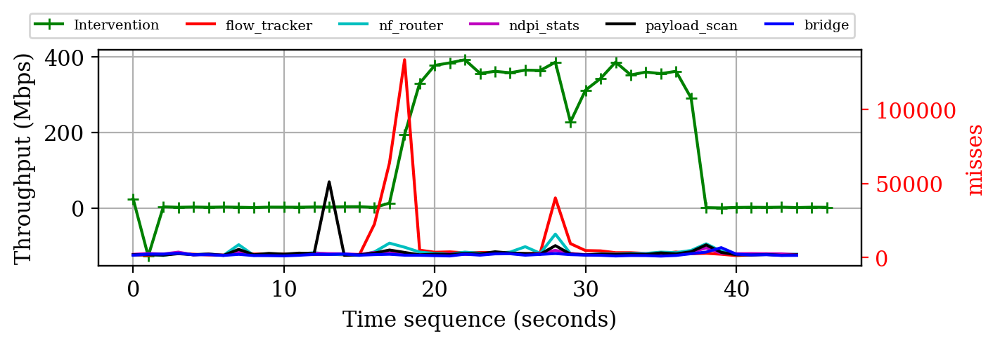

In [62]:
plot_feature_rs("LLC-load-misses", "misses", )

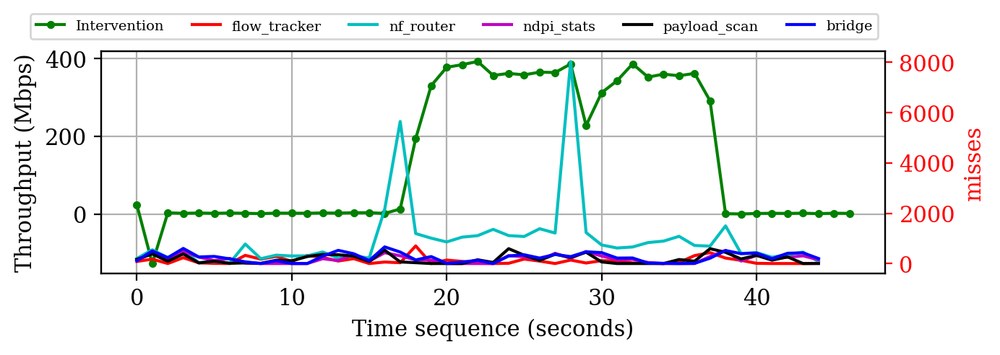

In [63]:
plot_feature_rs("LLC-store-misses", "misses", )

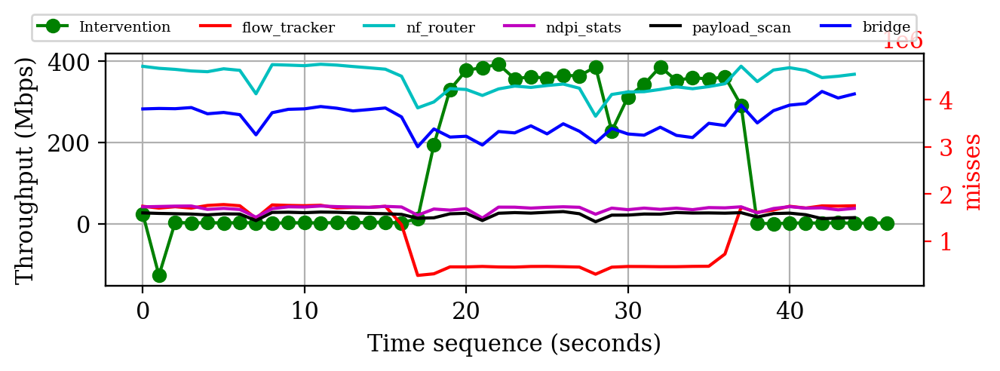

In [64]:
plot_feature_rs("LLC-stores", "misses", )

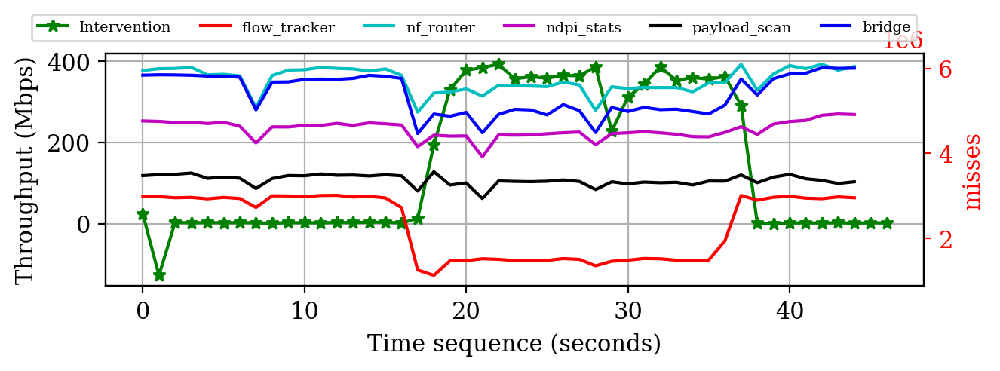

In [65]:
plot_feature_rs("LLC-loads", "misses", )

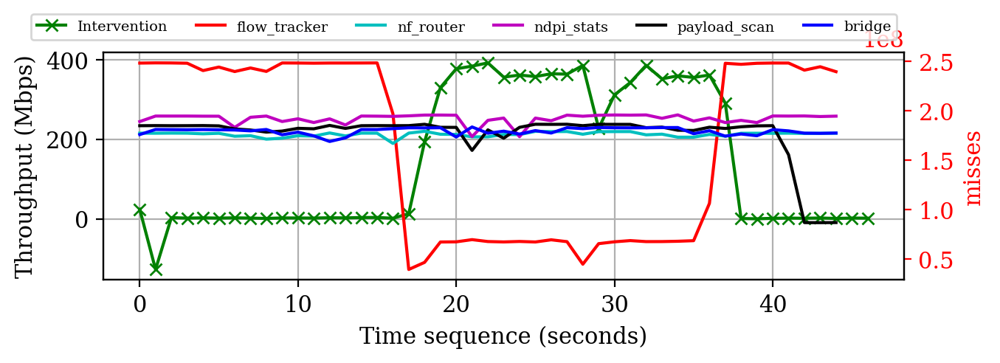

In [66]:
plot_feature_rs("dTLB-stores", "misses", )

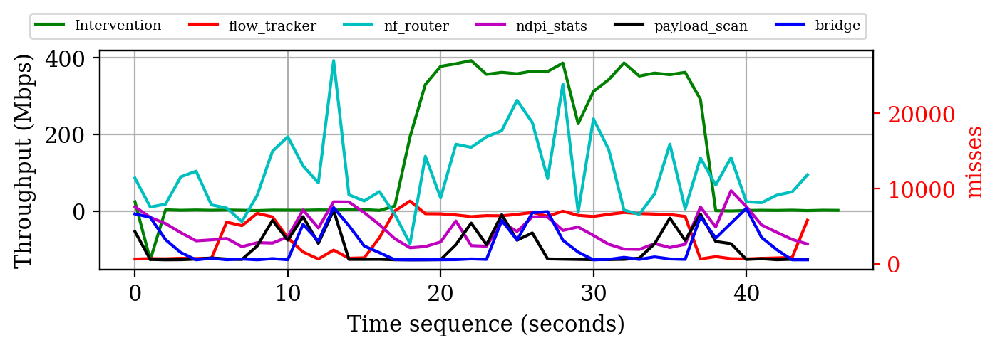

In [67]:
plot_feature_rs("dTLB-load-misses", "misses", )

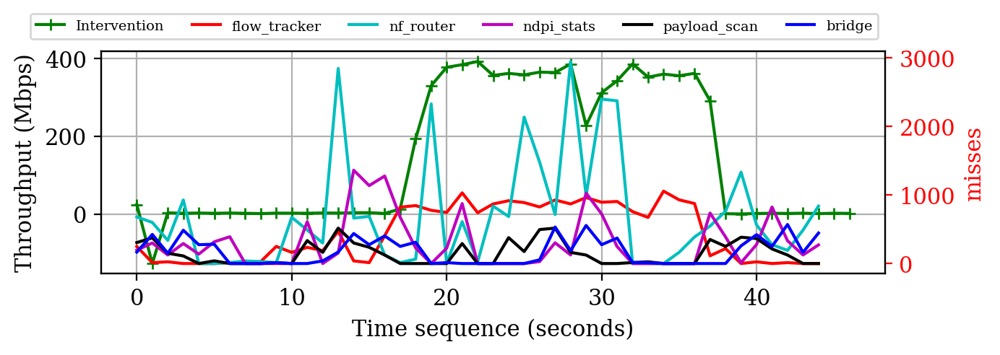

In [68]:
plot_feature_rs("dTLB-store-misses", "misses", )

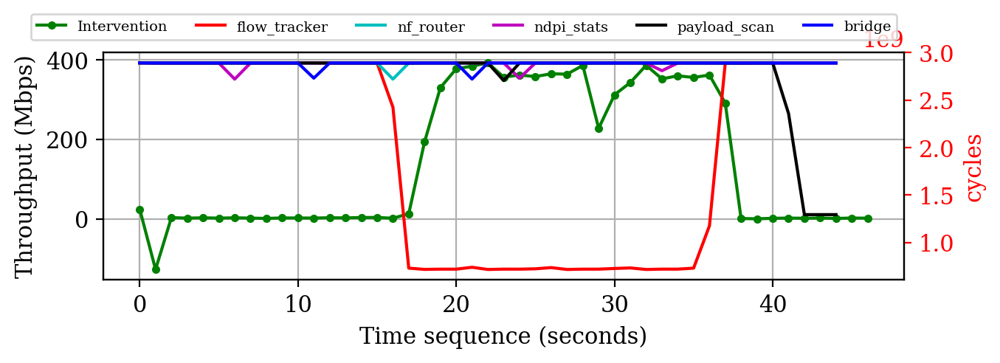

In [69]:
plot_feature_rs(",cycles", "cycles",)

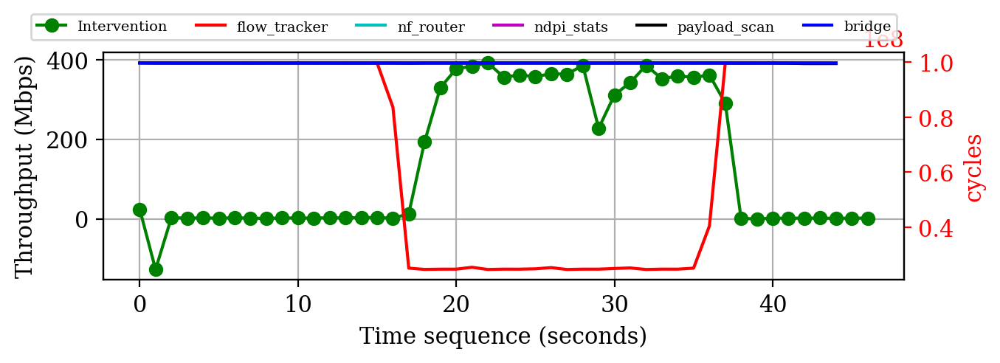

In [70]:
plot_feature_rs("bus-cycles", "cycles",)

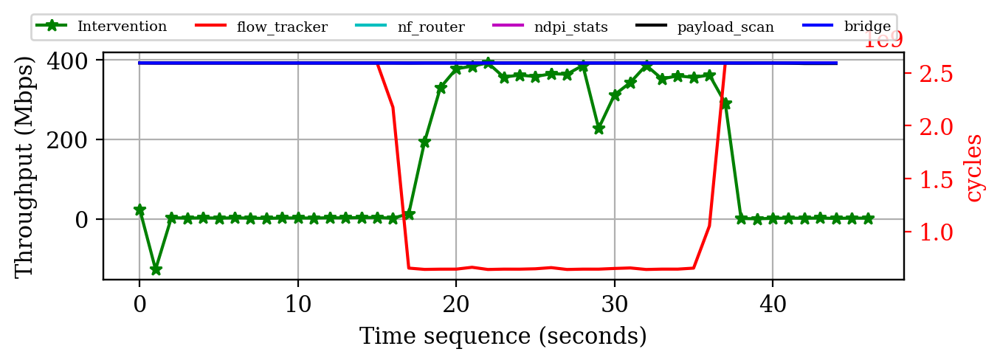

In [71]:
plot_feature_rs("ref-cycles", "cycles", )

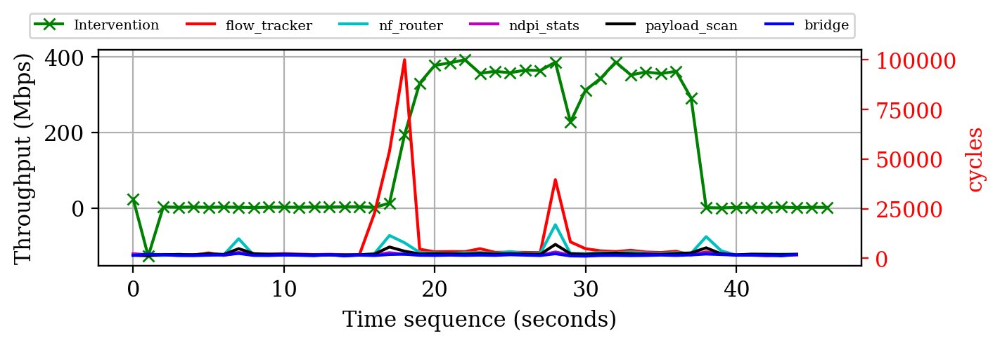

In [72]:
plot_feature_rs("node-loads", "cycles", )

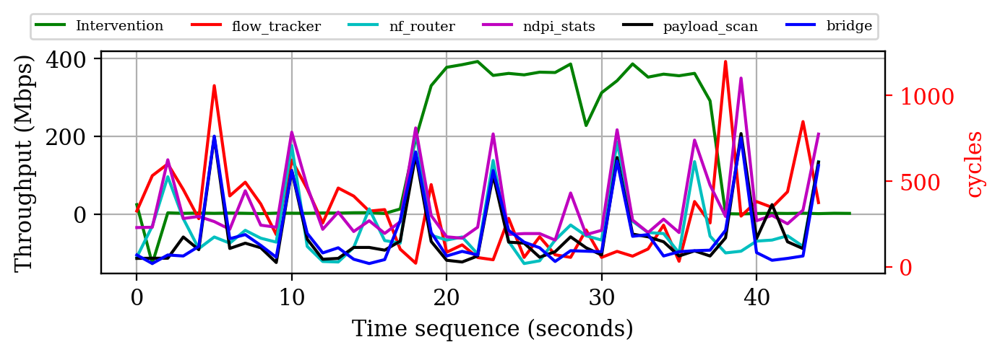

In [73]:
plot_feature_rs("node-load-misses", "cycles", )

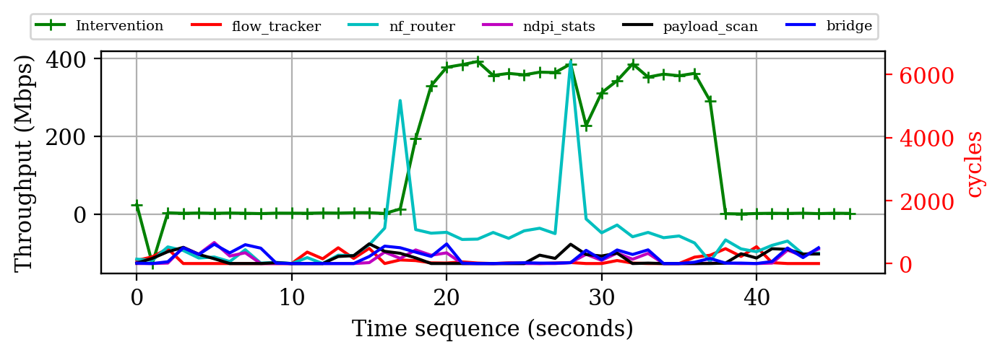

In [74]:
plot_feature_rs("node-stores", "cycles", )

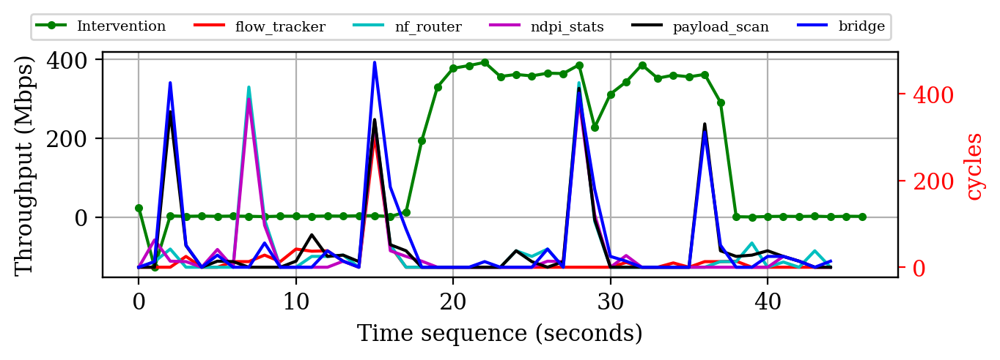

In [75]:
plot_feature_rs("node-store-misses", "cycles", )

### Case 2: tress-testing the Router

In [76]:
from IPython.display import IFrame
IFrame("../assets/case1.pdf", width=600, height=420)

In [77]:
exp_rs = "exp-4-1-3"

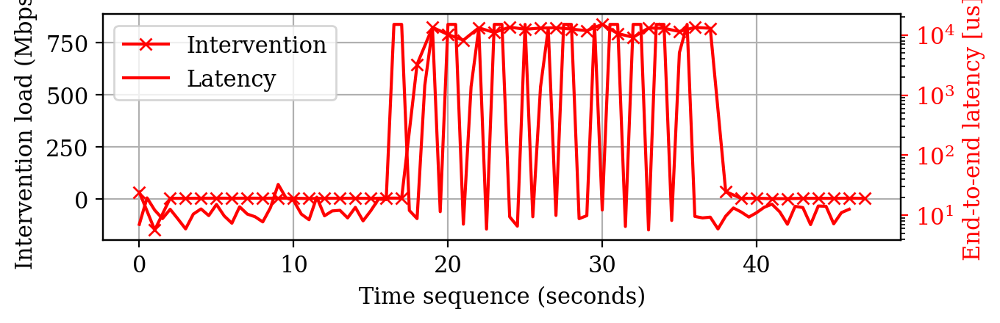

In [80]:
fig, ax = plt.subplots(figsize = (7,2))
ax.grid(True)
ax.set_xlabel("Time sequence (seconds)")
ax.set_ylabel("Intervention load (Mbps)")

ax2 = ax.twinx()
ax2.tick_params(axis='y', colors='red')
ax2.set_ylabel("End-to-end latency [us]", color="red")

tx = np.asarray(parse_seq("resource_stimulus", exp_rs, "tx_stats.csv"))
rx = np.asarray(parse_seq("resource_stimulus", exp_rs, "rx_stats.csv"))

diff = tx-rx

l = ax.plot(diff, marker=next(marker), color=next(cycol), label="Intervention")
lat = parse_seq("resource_stimulus", exp_rs, "latency.csv")
ax2.set_yscale("log")
l2 = ax2.plot(0.5*np.arange(0, len(lat)), lat, color="red", label="Latency")

lns = l+l2
labs = [l.get_label() for l in lns]
plt.legend(lns, labs)

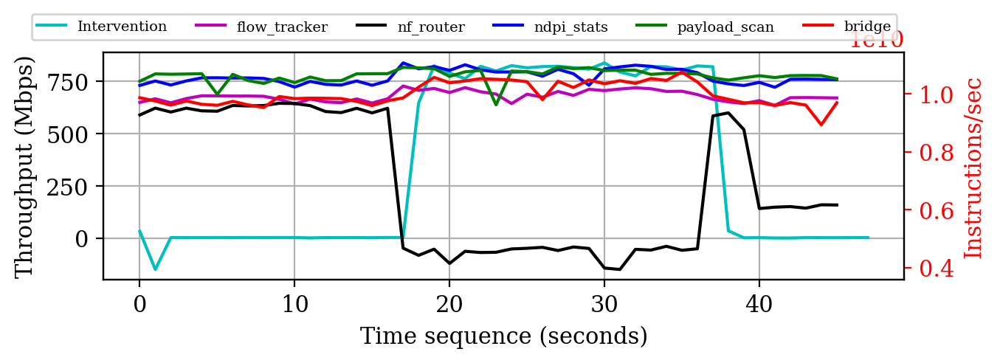

In [81]:
plot_feature_rs("instructions,", "Instructions/sec")

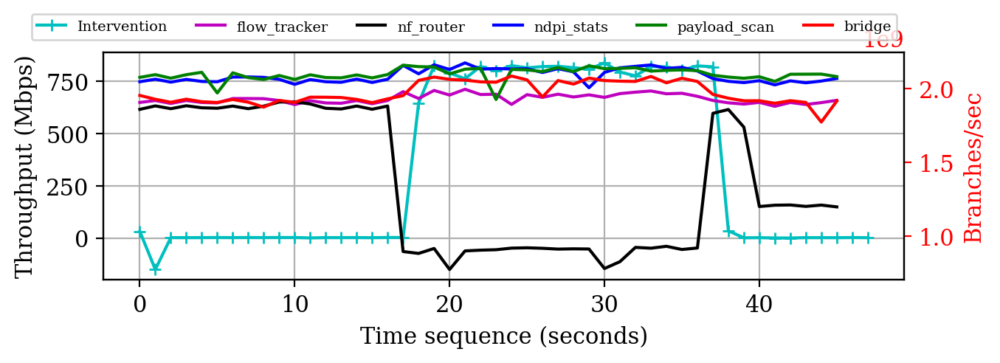

In [82]:
plot_feature_rs("branches,", "Branches/sec")

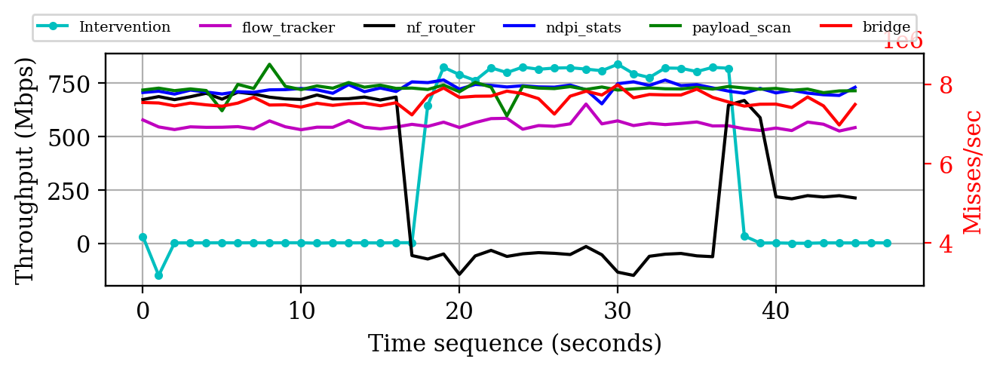

In [83]:
plot_feature_rs("branch-misses,", "Misses/sec")

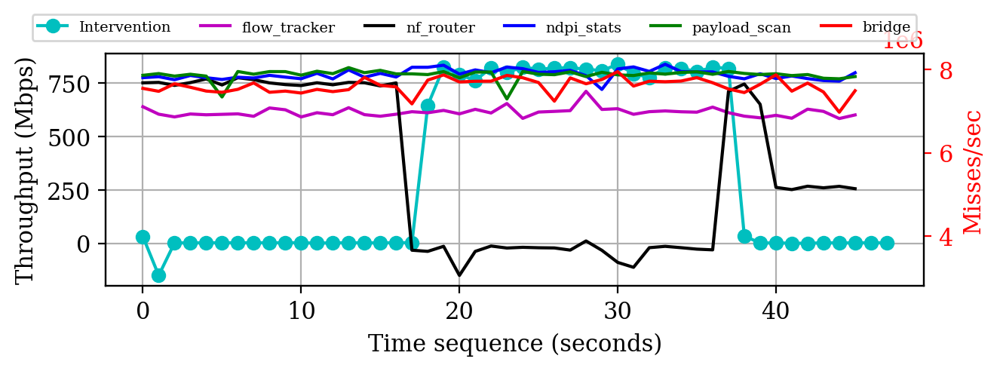

In [84]:
plot_feature_rs("branch-load-misses,", "Misses/sec")

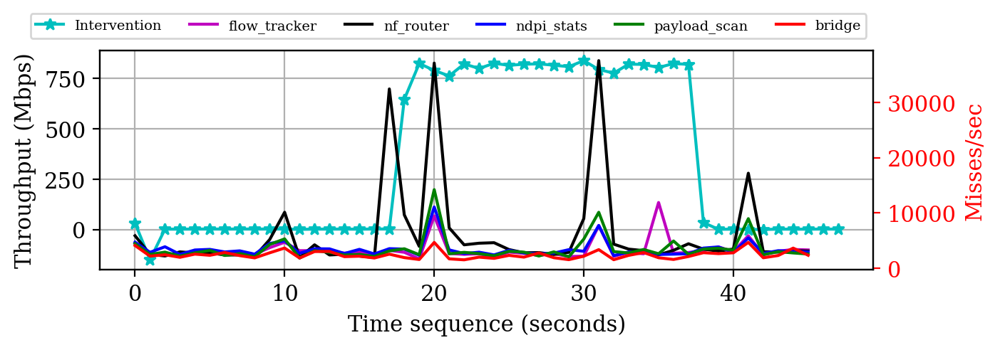

In [85]:
plot_feature_rs("cache-misses,", "Misses/sec")

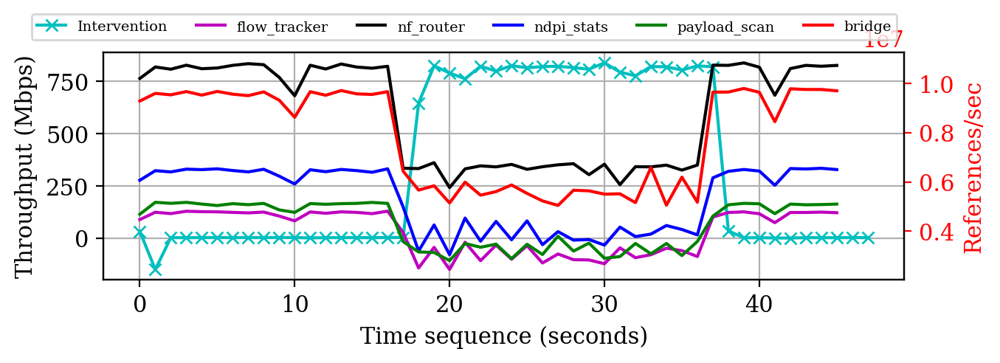

In [86]:
plot_feature_rs("cache-references,", "References/sec")

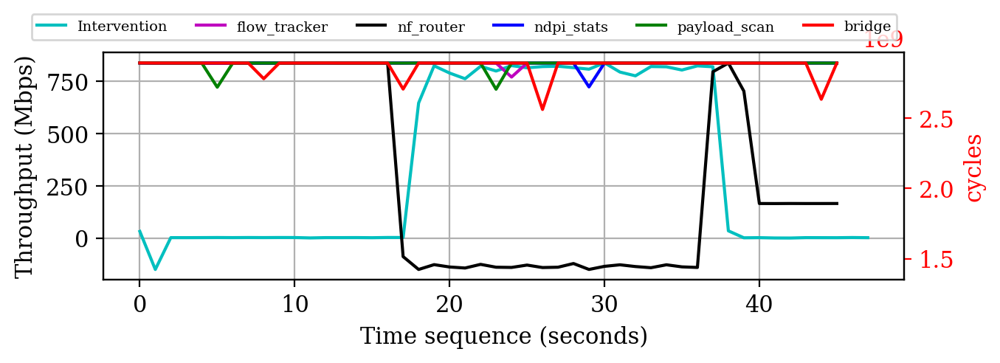

In [87]:
plot_feature_rs(",cycles,", "cycles")

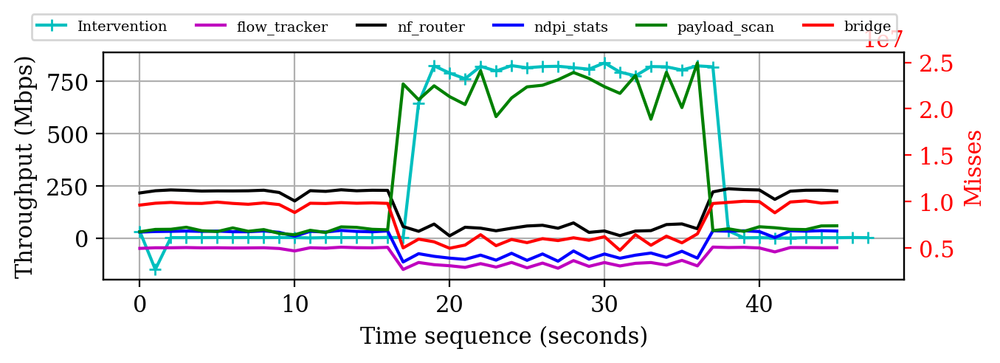

In [88]:
plot_feature_rs(",L1-dcache-load-misses,", "Misses")

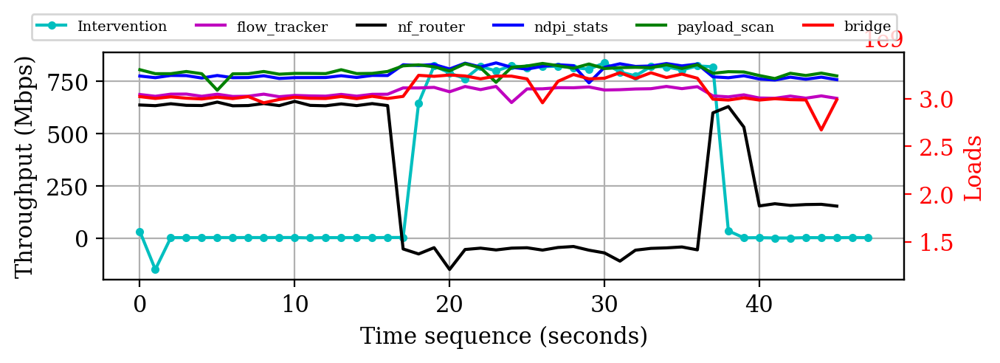

In [89]:
plot_feature_rs("L1-dcache-loads", "Loads")

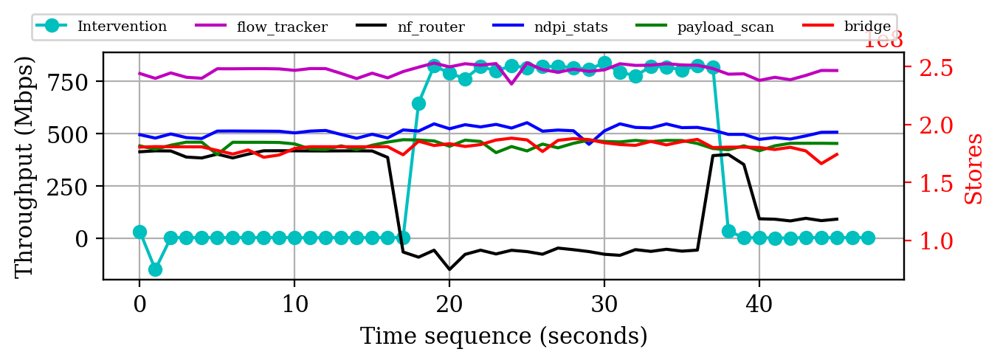

In [90]:
plot_feature_rs("L1-dcache-stores", "Stores")

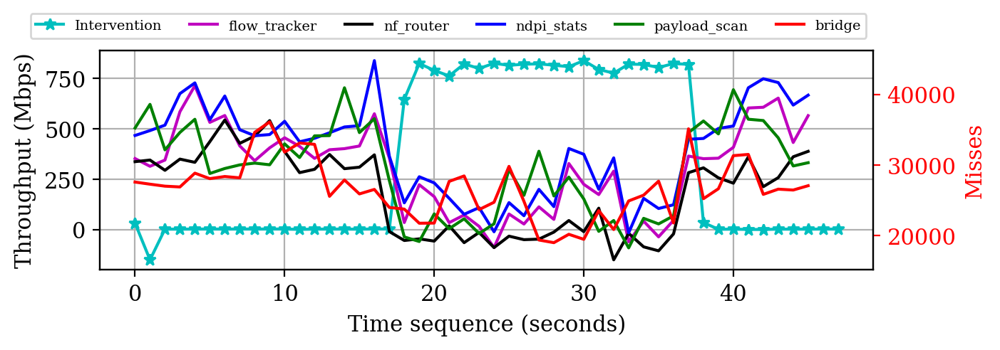

In [91]:
plot_feature_rs("L1-icache-load-misses", "Misses")

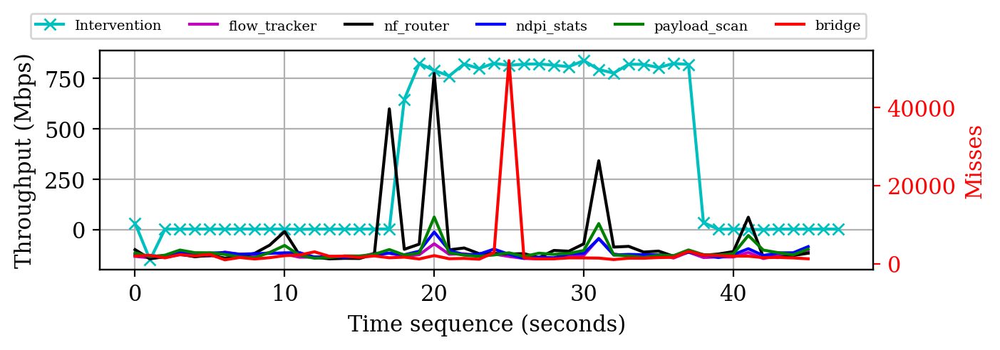

In [92]:
plot_feature_rs("LLC-load-misses", "Misses")

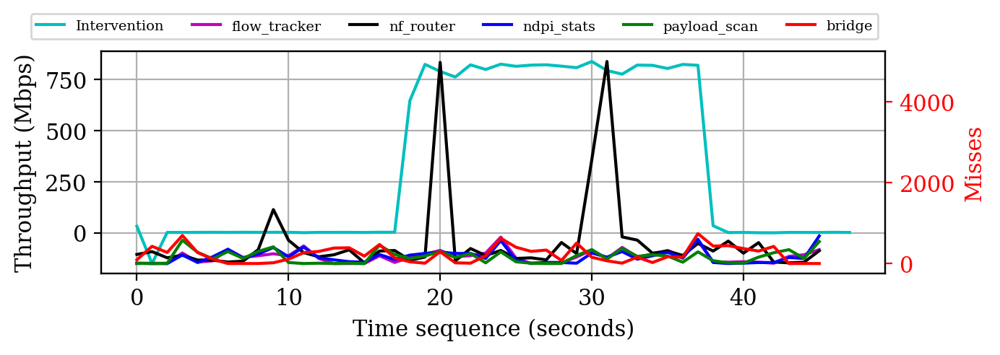

In [93]:
plot_feature_rs("LLC-store-misses", "Misses")

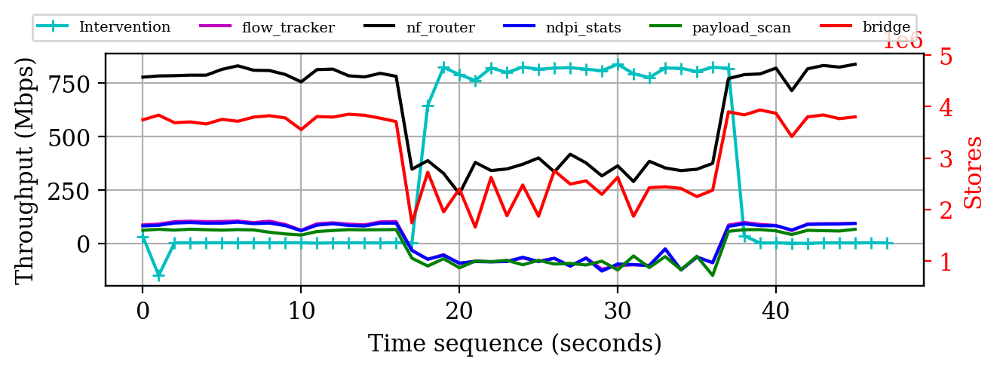

In [94]:
plot_feature_rs("LLC-stores", "Stores")

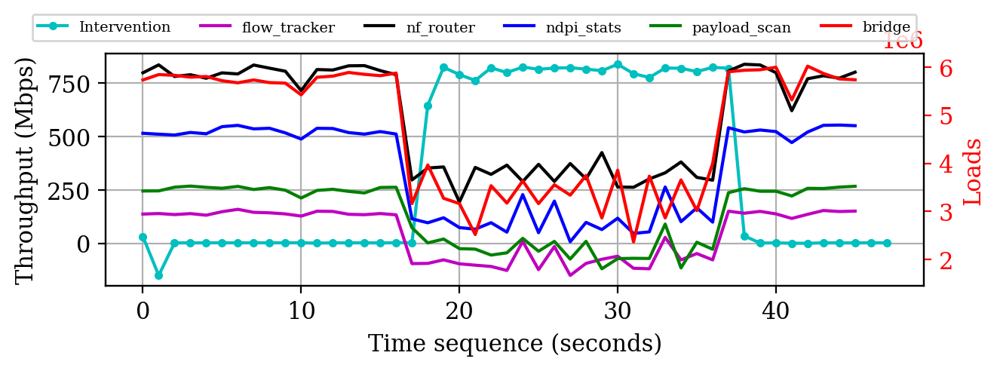

In [95]:
plot_feature_rs("LLC-loads", "Loads")

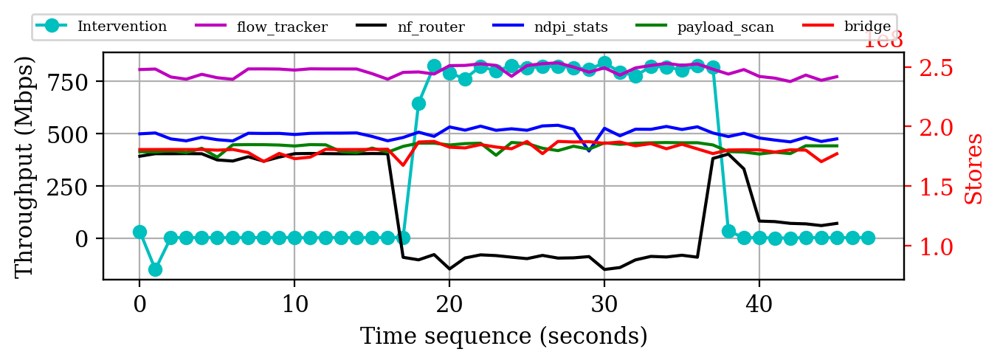

In [96]:
plot_feature_rs("dTLB-stores", "Stores")

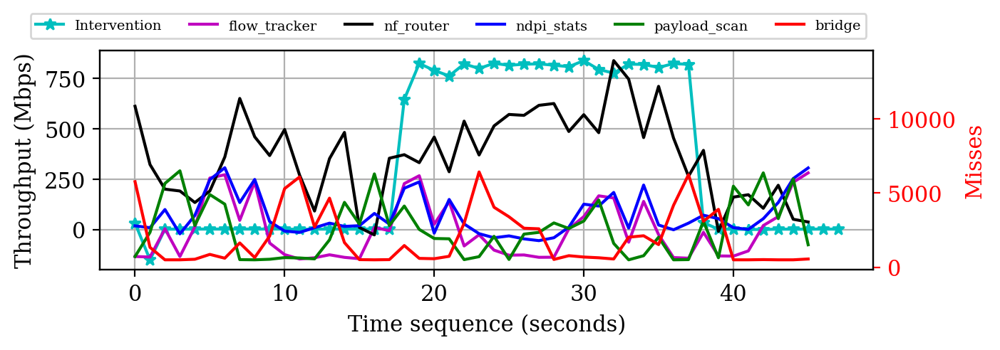

In [97]:
plot_feature_rs("dTLB-load-misses", "Misses")

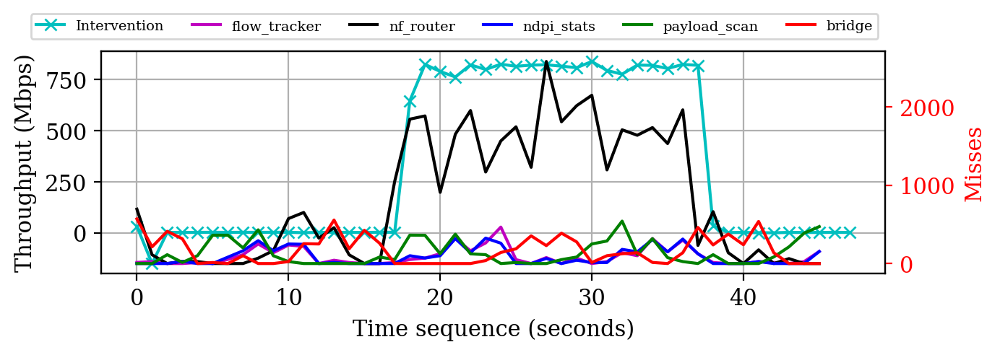

In [98]:
plot_feature_rs("dTLB-store-misses", "Misses")

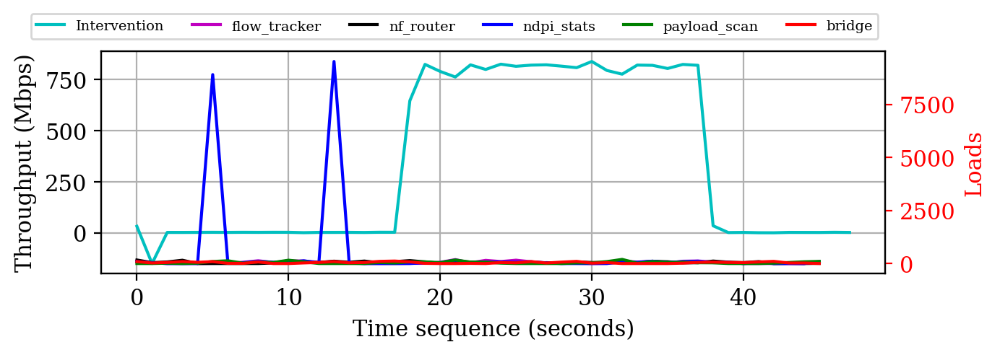

In [99]:
plot_feature_rs("iTLB-loads", "Loads")

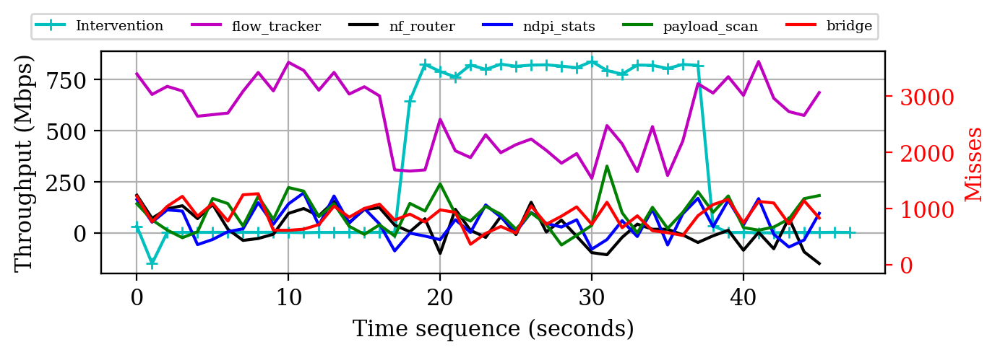

In [100]:
plot_feature_rs("iTLB-load-misses", "Misses")

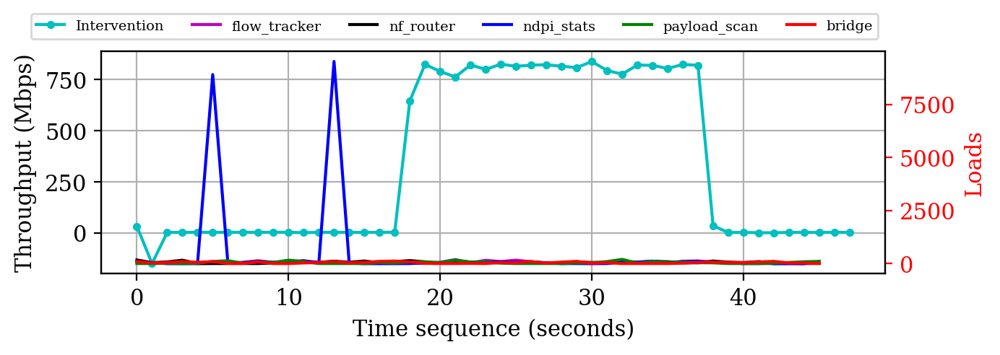

In [101]:
plot_feature_rs("iTLB-loads", "Loads")

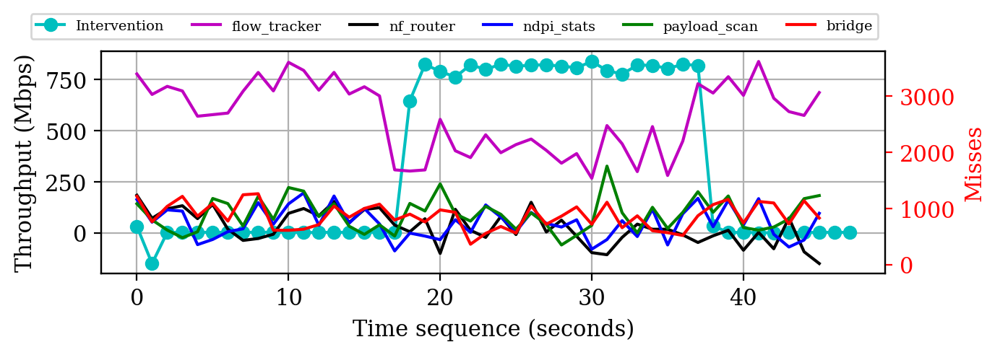

In [102]:
plot_feature_rs("iTLB-load-misses", "Misses")

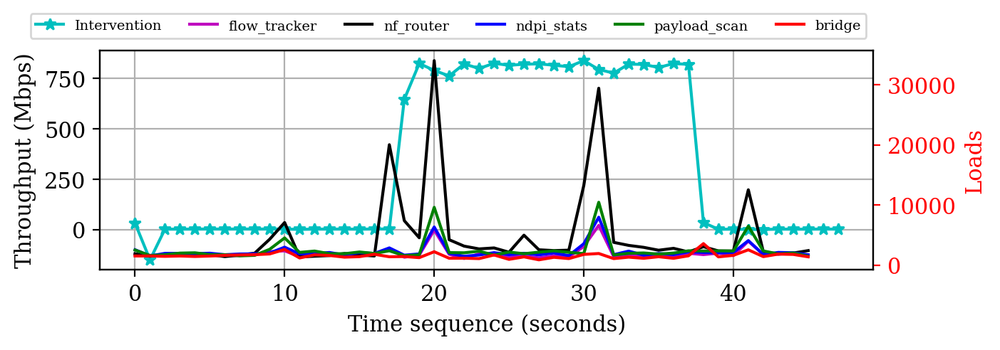

In [103]:
plot_feature_rs("node-loads", "Loads")

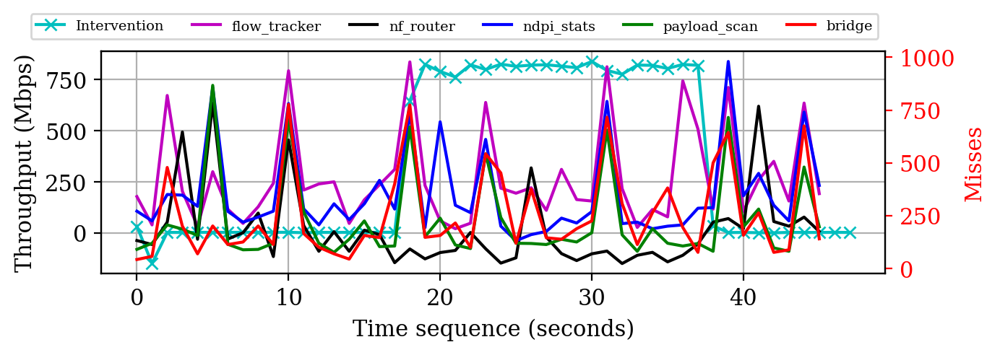

In [104]:
plot_feature_rs("node-load-misses", "Misses")

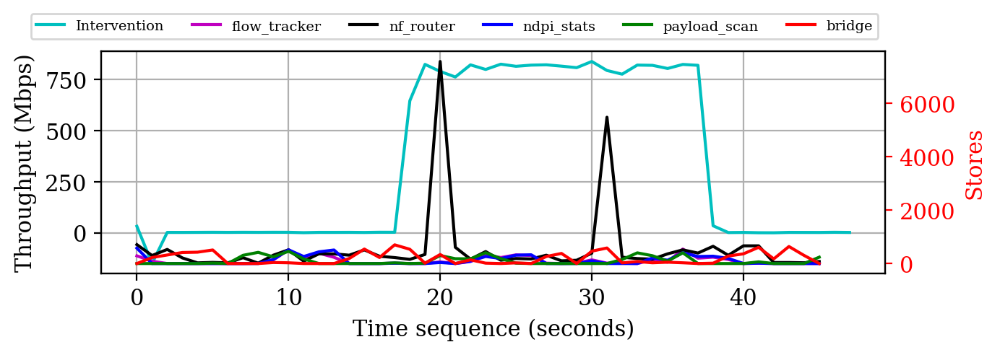

In [105]:
plot_feature_rs("node-stores", "Stores")

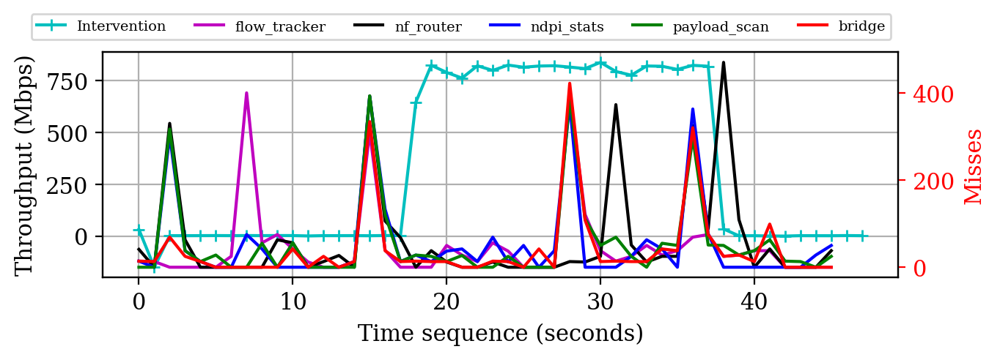

In [106]:
plot_feature_rs("node-store-misses", "Misses")

### Case 3: stress-testing the nDPI

In [107]:
from IPython.display import IFrame
IFrame("../assets/case2.pdf", width=600, height=420)

In [108]:
exp_rs = "exp-5-1-2"

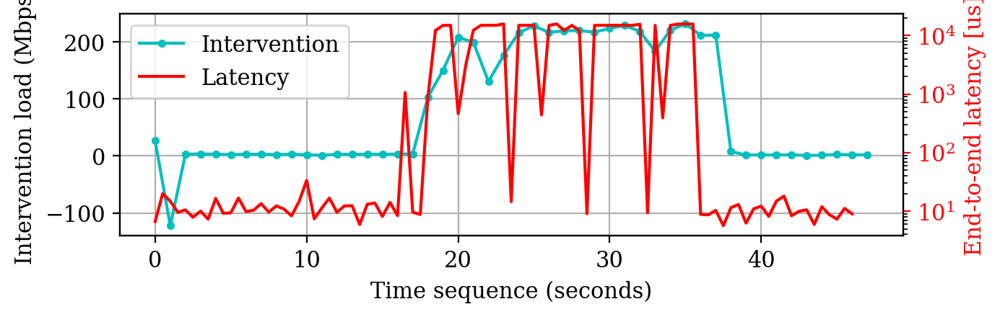

In [109]:
fig, ax = plt.subplots(figsize = (7,2))
ax.grid(True)
ax.set_xlabel("Time sequence (seconds)")
ax.set_ylabel("Intervention load (Mbps)")

ax2 = ax.twinx()
ax2.tick_params(axis='y', colors='red')
ax2.set_ylabel("End-to-end latency [us]", color="red")

tx = np.asarray(parse_seq("resource_stimulus", exp_rs, "tx_stats.csv"))
rx = np.asarray(parse_seq("resource_stimulus", exp_rs, "rx_stats.csv"))

if len(tx) != len(rx):
    for _ in range(len(tx)-len(rx)):
        rx = np.append(rx, [2000])

diff = tx-rx

l = ax.plot(diff, marker=next(marker), color=next(cycol), label="Intervention")
lat = parse_seq("resource_stimulus", exp_rs, "latency.csv")
ax2.set_yscale("log")
l2 = ax2.plot(0.5*np.arange(0, len(lat)), lat, color="red", label="Latency")

lns = l+l2
labs = [l.get_label() for l in lns]
plt.legend(lns, labs)

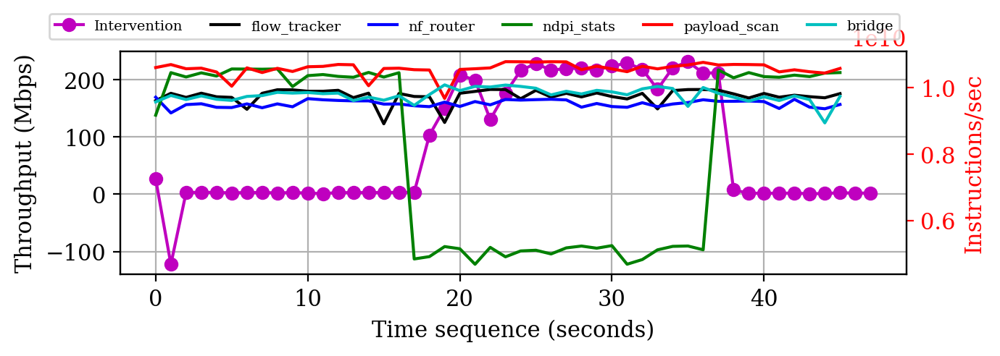

In [110]:
plot_feature_rs("instructions,", "Instructions/sec")

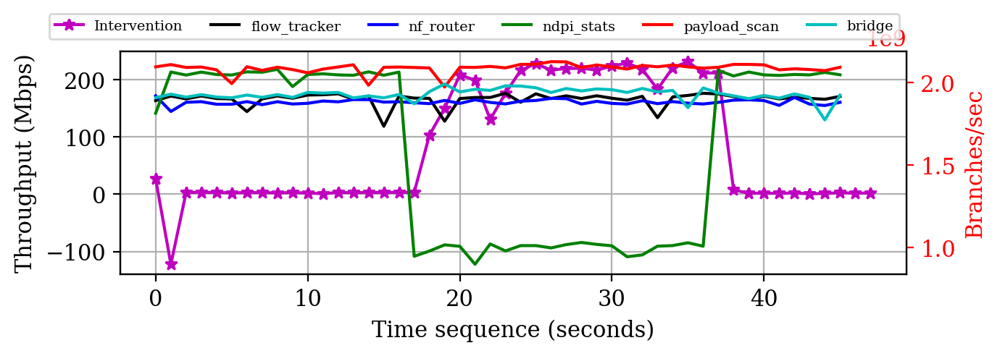

In [111]:
plot_feature_rs("branches,", "Branches/sec")

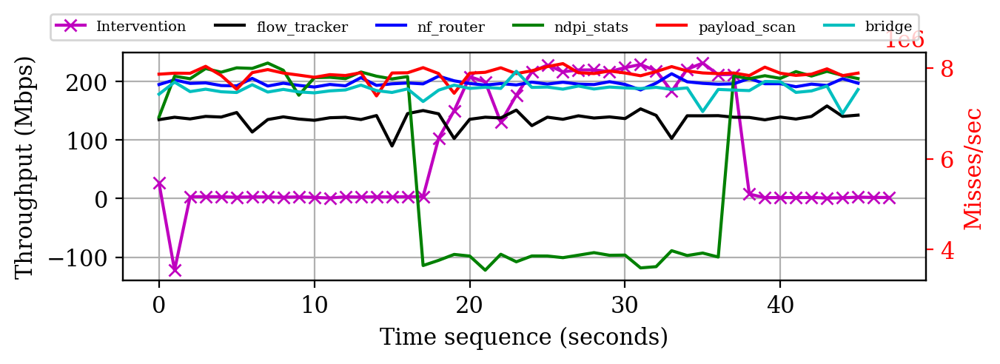

In [112]:
plot_feature_rs("branch-misses,", "Misses/sec")

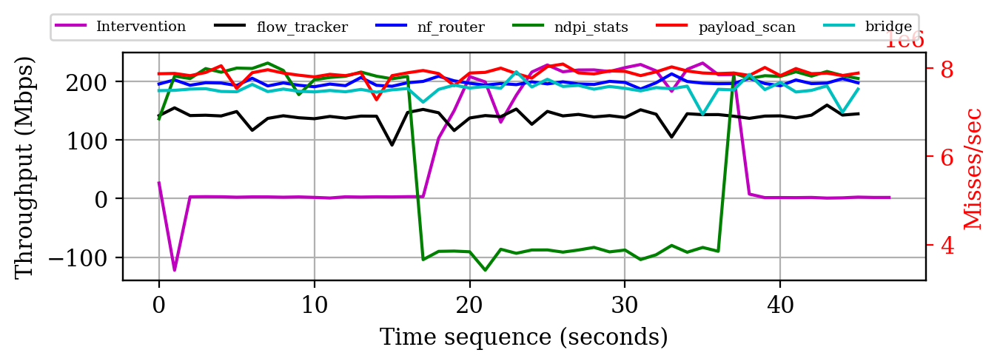

In [113]:
plot_feature_rs("branch-load-misses,", "Misses/sec")

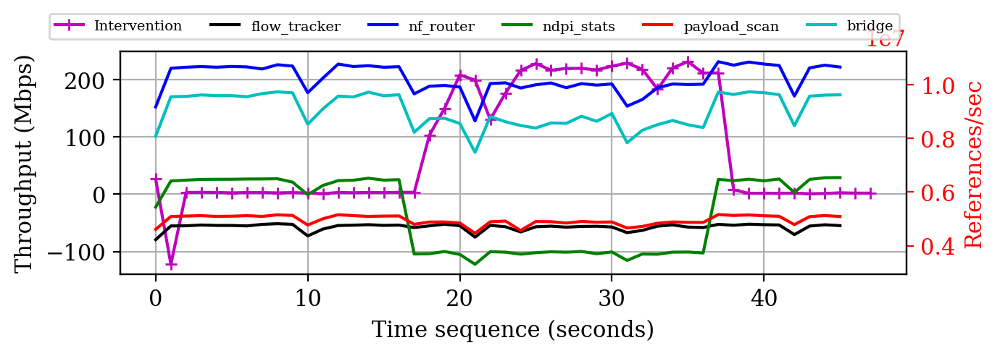

In [114]:
plot_feature_rs("cache-references", "References/sec")

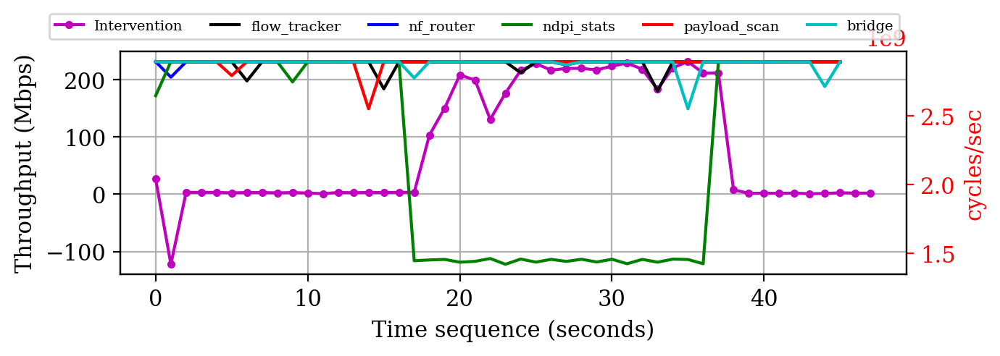

In [115]:
plot_feature_rs(",cycles", "cycles/sec")

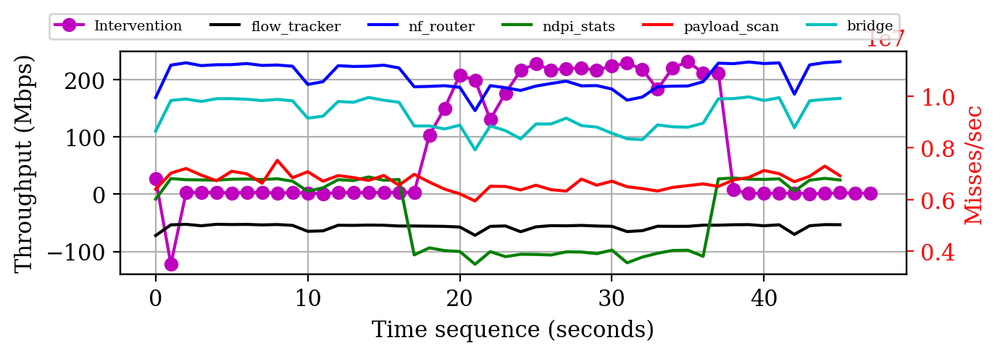

In [116]:
plot_feature_rs("L1-dcache-load-misses", "Misses/sec")

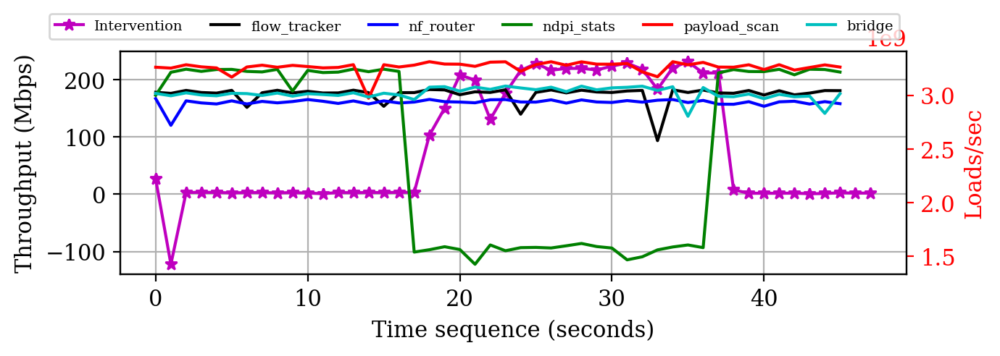

In [117]:
plot_feature_rs("L1-dcache-loads", "Loads/sec")

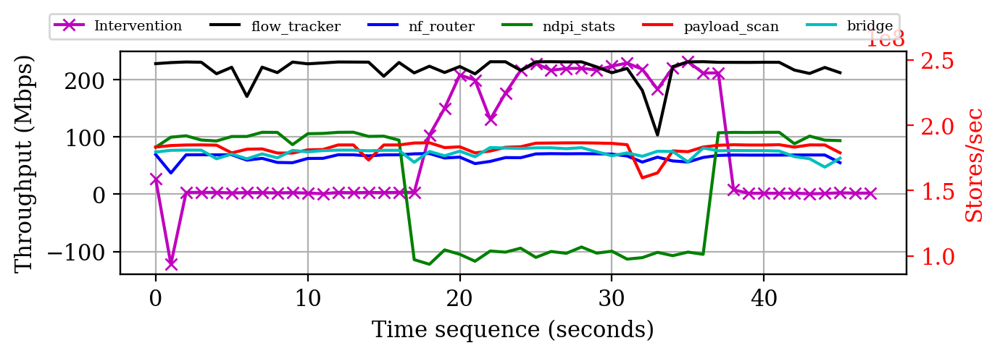

In [118]:
plot_feature_rs("L1-dcache-stores", "Stores/sec")

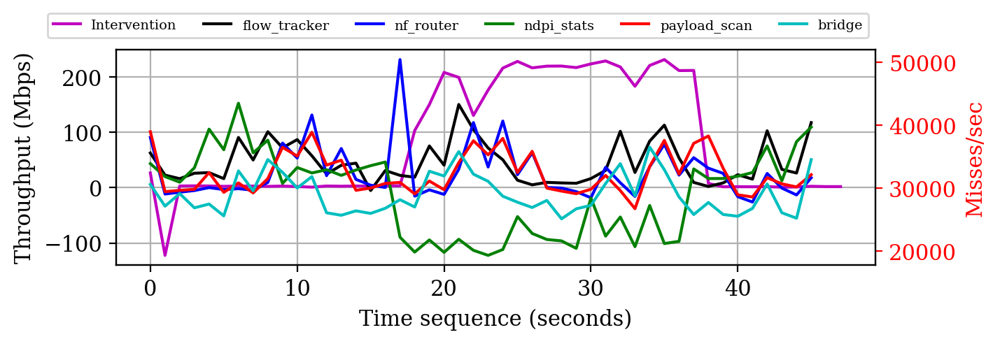

In [119]:
plot_feature_rs("L1-icache-load-misses", "Misses/sec")

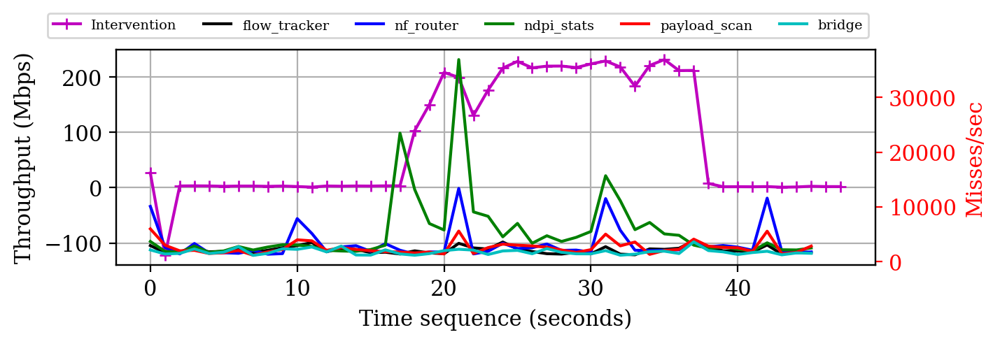

In [120]:
plot_feature_rs("LLC-load-misses", "Misses/sec")

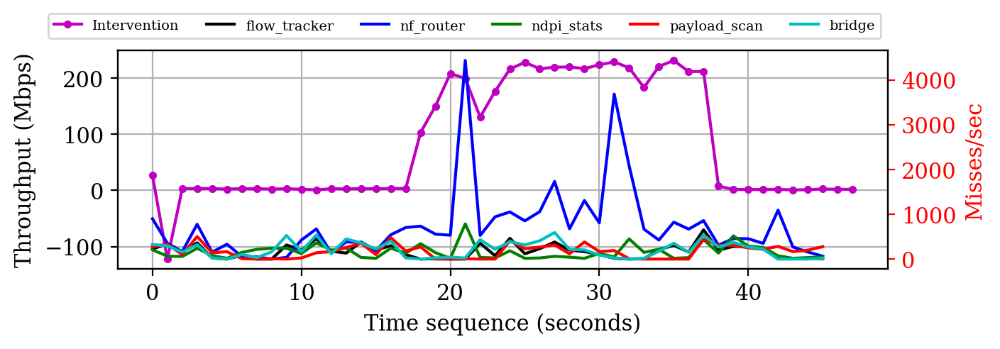

In [121]:
plot_feature_rs("LLC-store-misses", "Misses/sec")

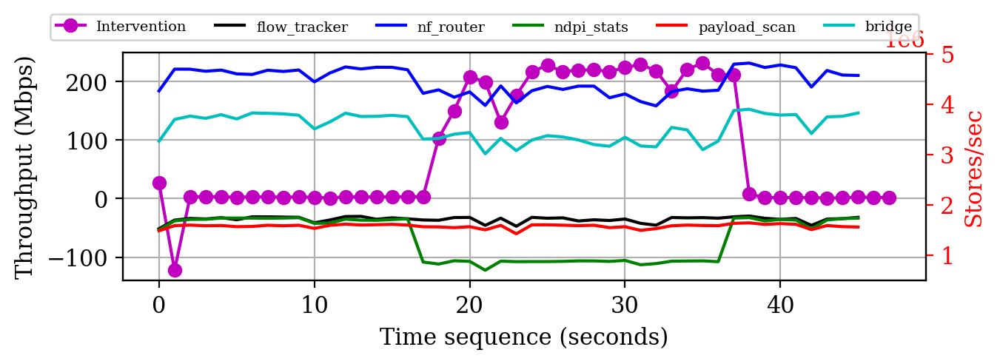

In [122]:
plot_feature_rs("LLC-stores", "Stores/sec")

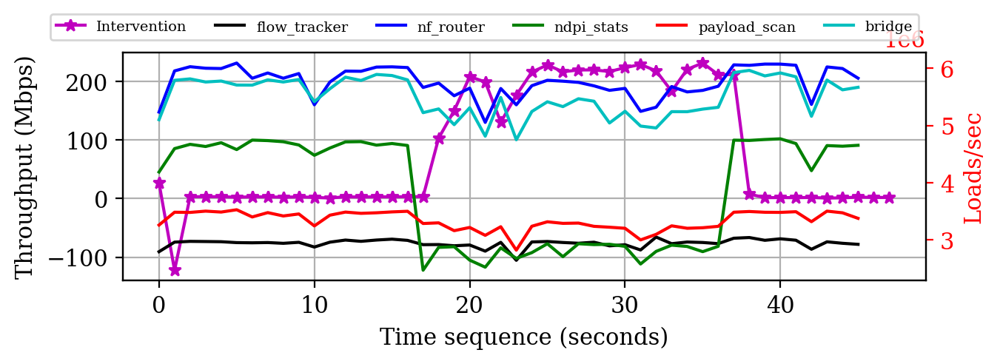

In [123]:
plot_feature_rs("LLC-loads", "Loads/sec")

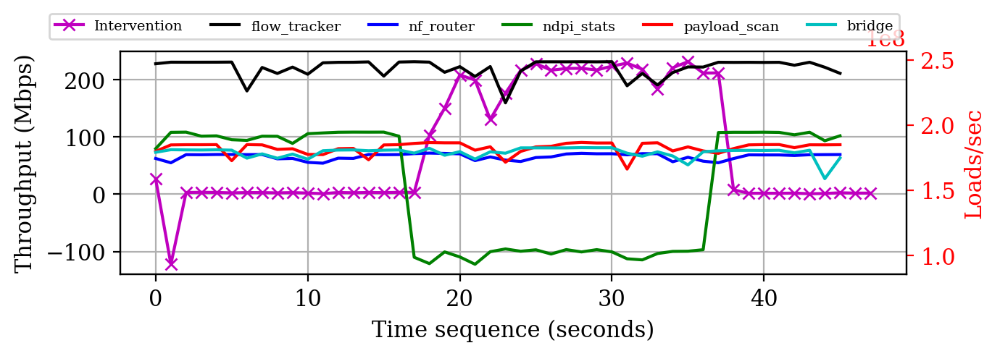

In [124]:
plot_feature_rs("dTLB-stores", "Loads/sec")

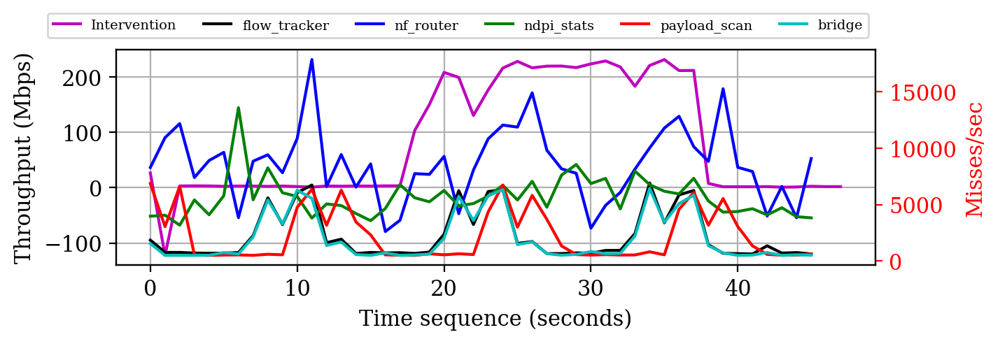

In [125]:
plot_feature_rs("dTLB-load-misses", "Misses/sec")

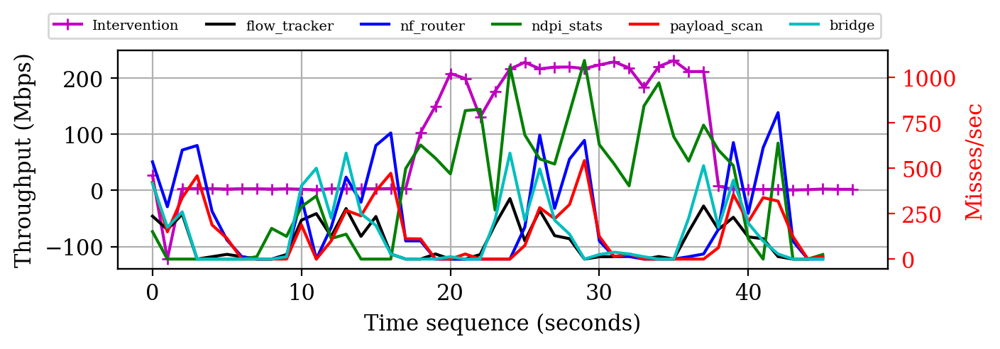

In [126]:
plot_feature_rs("dTLB-store-misses", "Misses/sec")

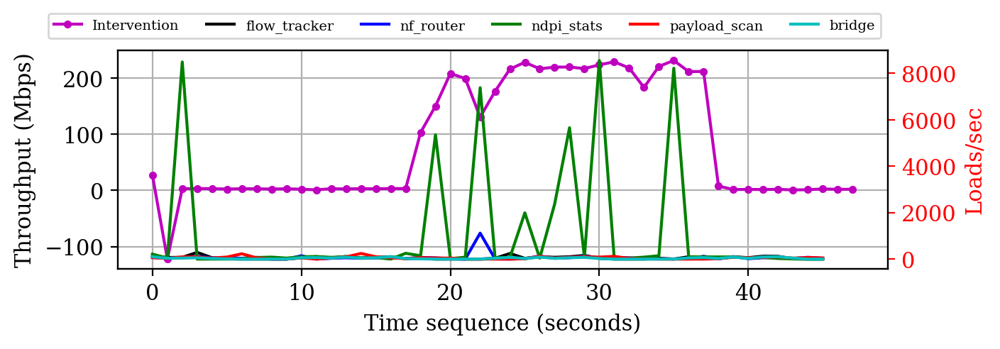

In [127]:
plot_feature_rs("iTLB-loads", "Loads/sec")

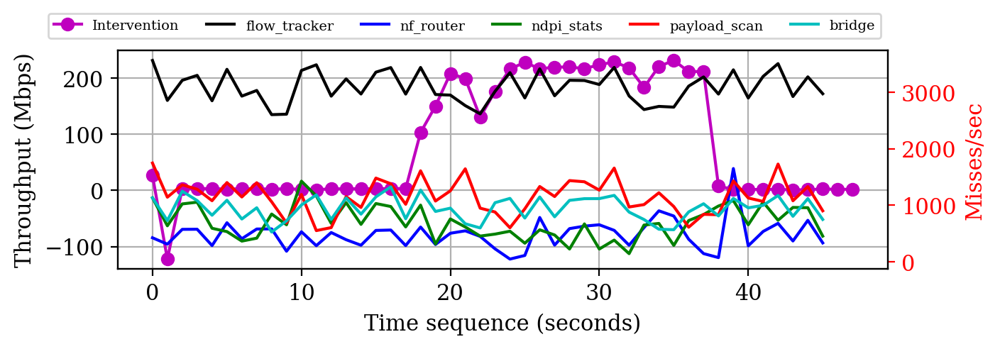

In [128]:
plot_feature_rs("iTLB-load-misses", "Misses/sec")

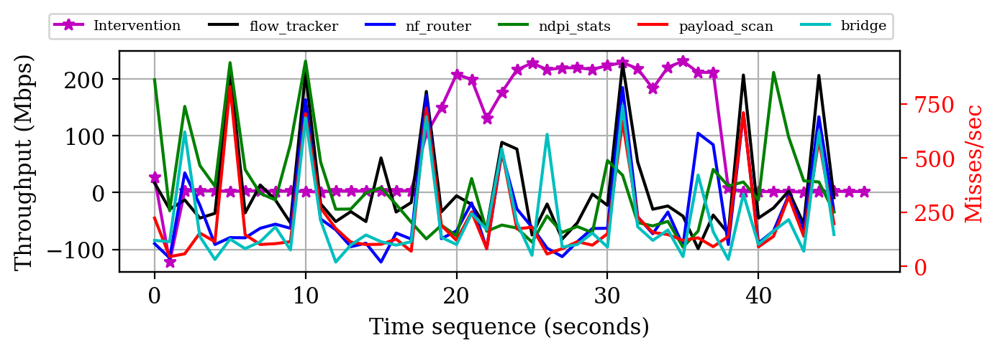

In [129]:
plot_feature_rs("node-load-misses", "Misses/sec")

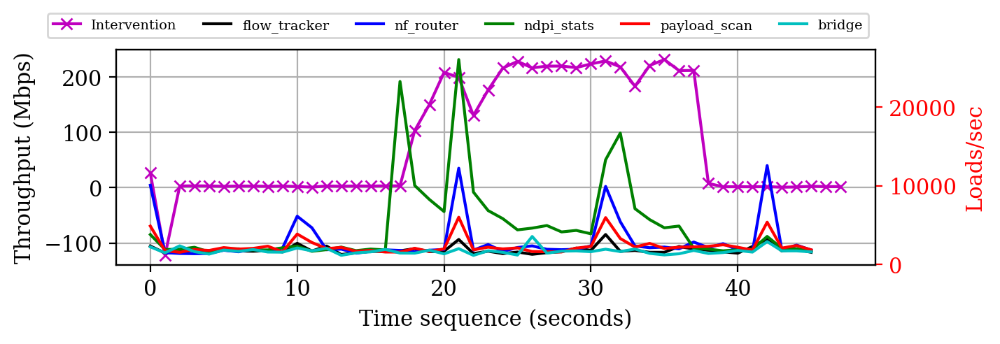

In [130]:
plot_feature_rs("node-loads", "Loads/sec")

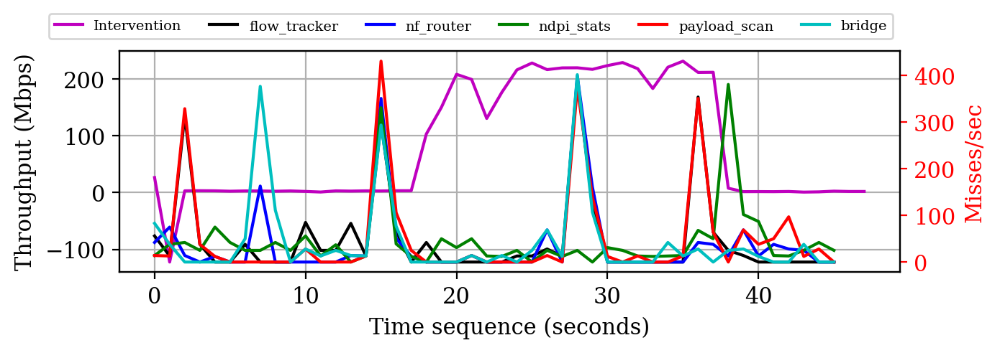

In [131]:
plot_feature_rs("node-store-misses", "Misses/sec")

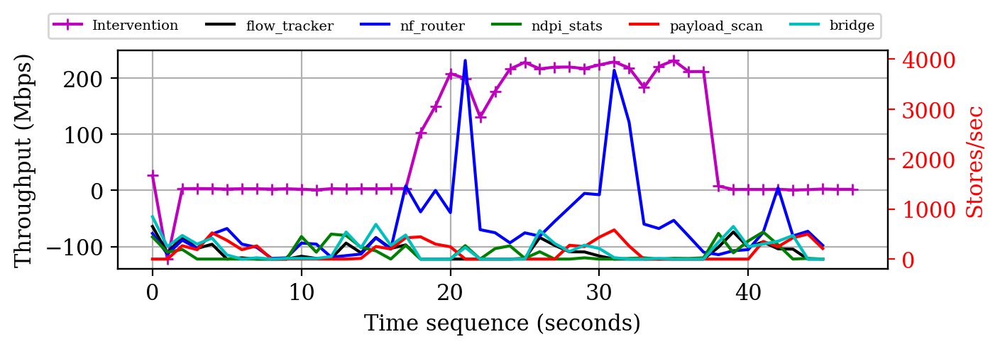

In [132]:
plot_feature_rs("node-stores", "Stores/sec")

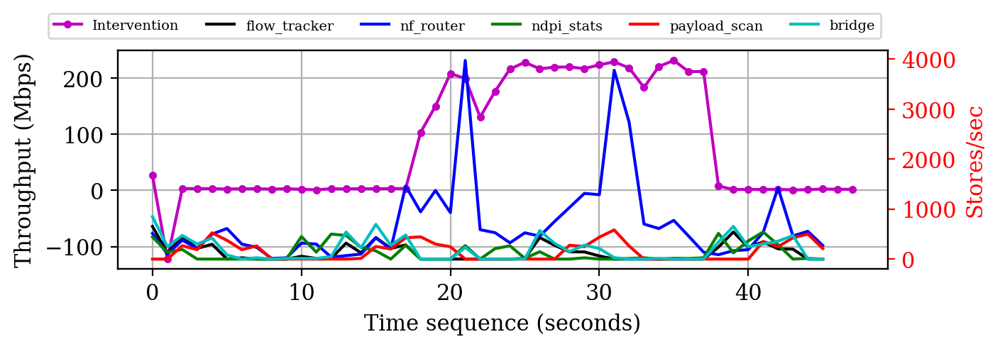

In [133]:
plot_feature_rs("node-stores", "Stores/sec")

### Case 4: stress-testing the Payload_scan

In [134]:
from IPython.display import IFrame
IFrame("../assets/case4.pdf", width=600, height=420)

In [140]:
exp_rs = "exp-6-1-4"

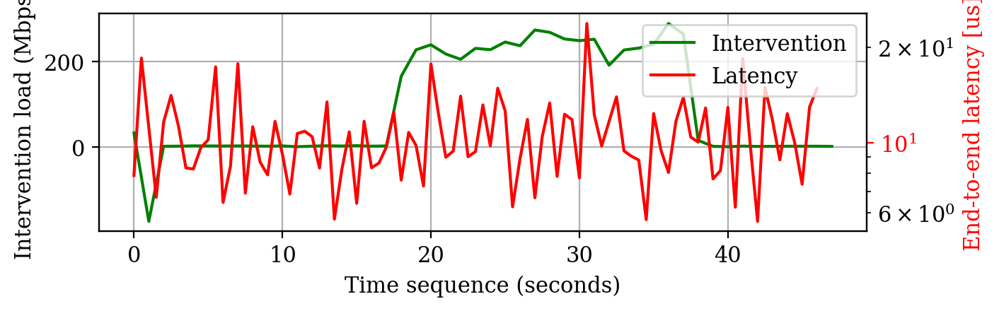

In [141]:
fig, ax = plt.subplots(figsize = (7,2))
ax.grid(True)
ax.set_xlabel("Time sequence (seconds)")
ax.set_ylabel("Intervention load (Mbps)")

ax2 = ax.twinx()
ax2.tick_params(axis='y', colors='red')
ax2.set_ylabel("End-to-end latency [us]", color="red")

tx = np.asarray(parse_seq("resource_stimulus", exp_rs, "tx_stats.csv"))
rx = np.asarray(parse_seq("resource_stimulus", exp_rs, "rx_stats.csv"))

diff = tx-rx

l = ax.plot(diff, marker=next(marker), color=next(cycol), label="Intervention")
lat = parse_seq("resource_stimulus", exp_rs, "latency.csv")
ax2.set_yscale("log")
l2 = ax2.plot(0.5*np.arange(0, len(lat)), lat, color="red", label="Latency")

lns = l+l2
labs = [l.get_label() for l in lns]
plt.legend(lns, labs)

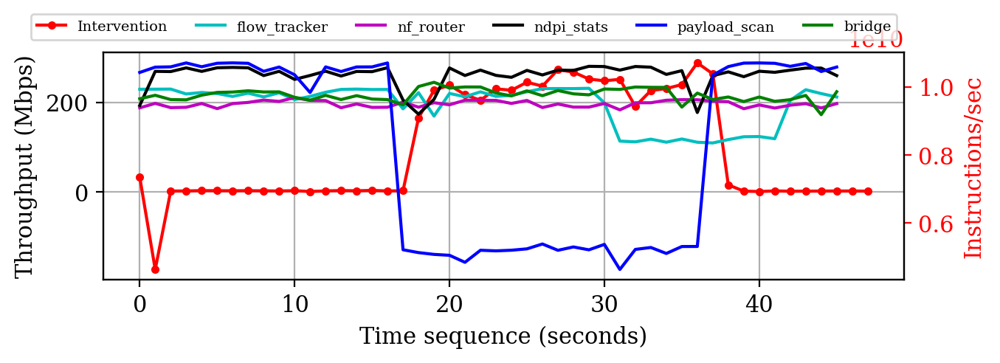

In [143]:
plot_feature_rs("instructions,", "Instructions/sec",)

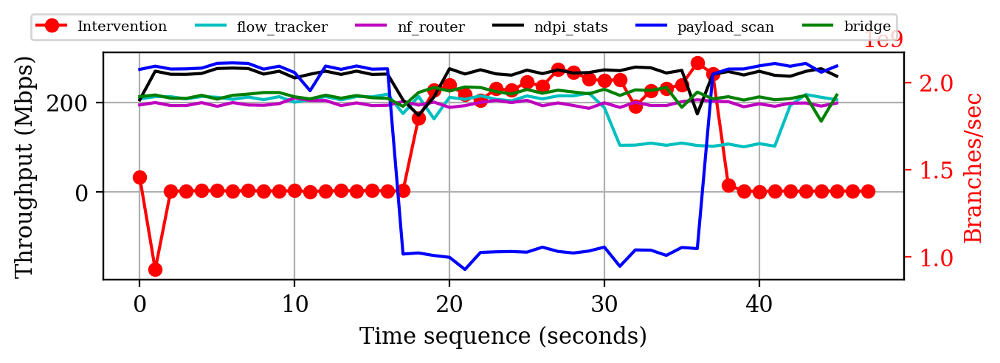

In [144]:
plot_feature_rs("branches,", "Branches/sec",)

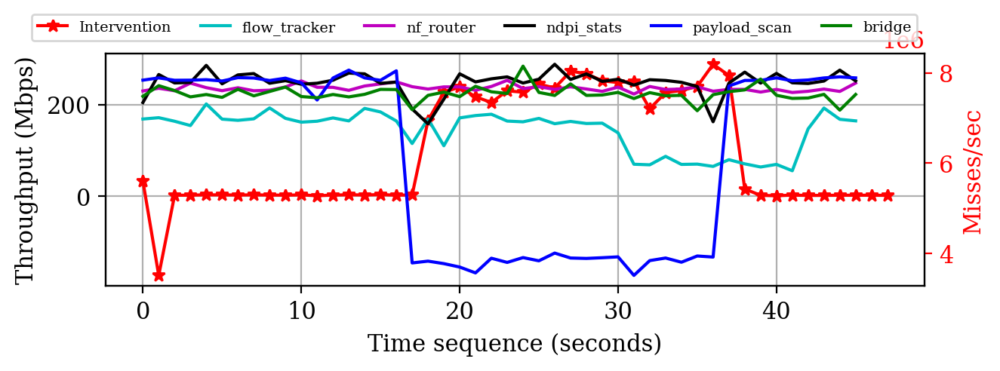

In [145]:
plot_feature_rs("branch-misses", "Misses/sec",)

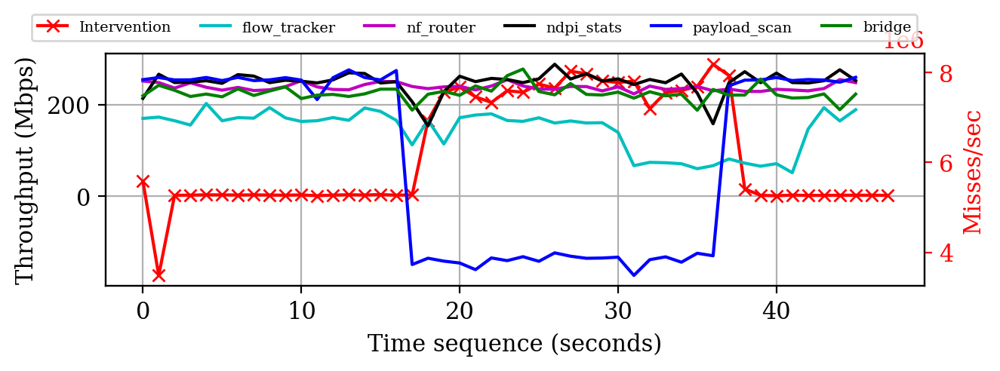

In [146]:
plot_feature_rs("branch-load-misses", "Misses/sec",)

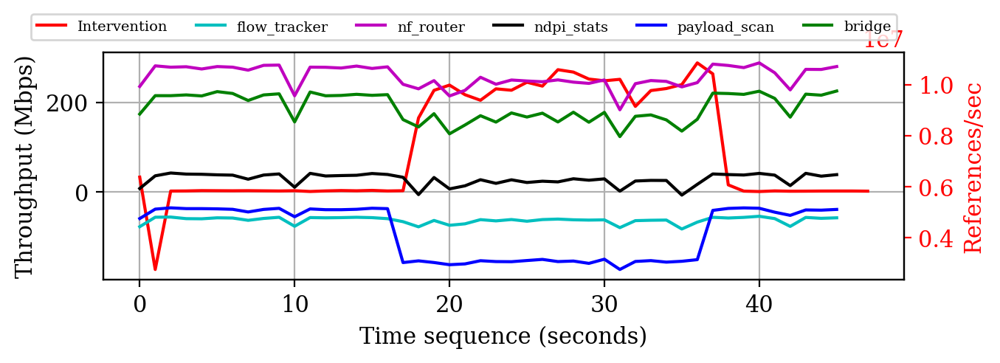

In [147]:
plot_feature_rs("cache-references", "References/sec",)

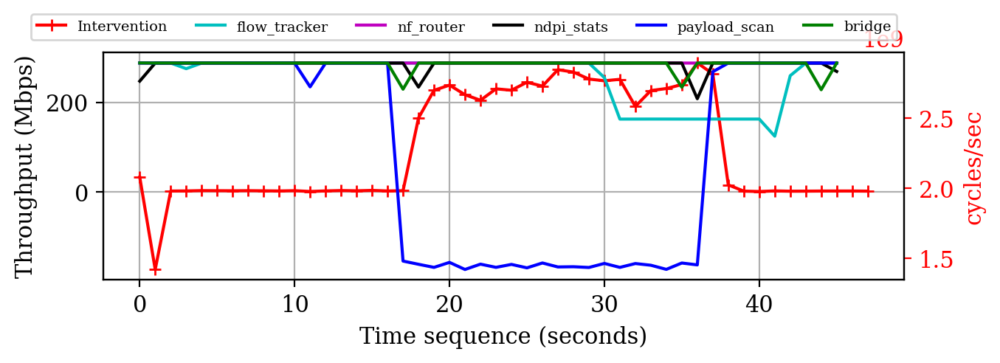

In [148]:
plot_feature_rs(",cycles", "cycles/sec",)

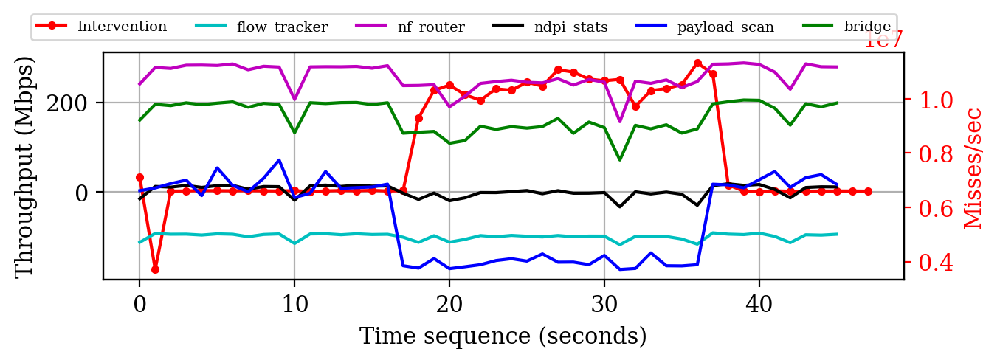

In [149]:
plot_feature_rs("L1-dcache-load-misses", "Misses/sec",)

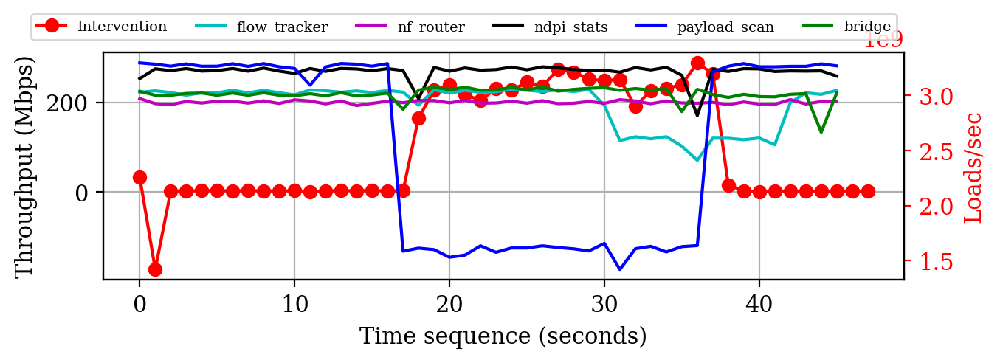

In [150]:
plot_feature_rs("L1-dcache-loads", "Loads/sec",)

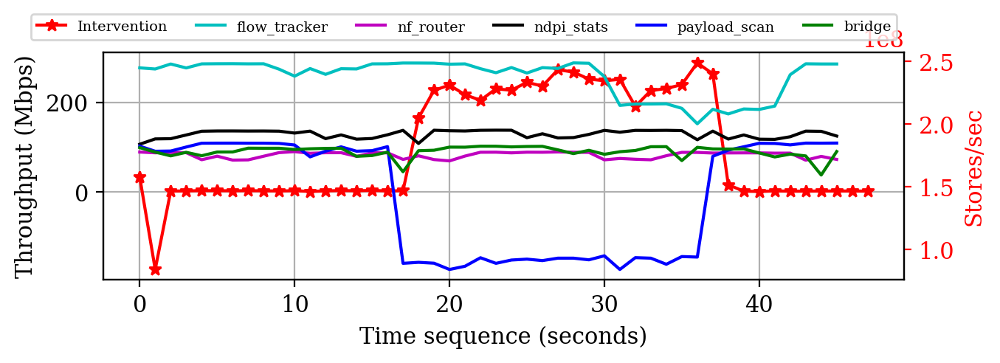

In [151]:
plot_feature_rs("L1-dcache-stores", "Stores/sec",)

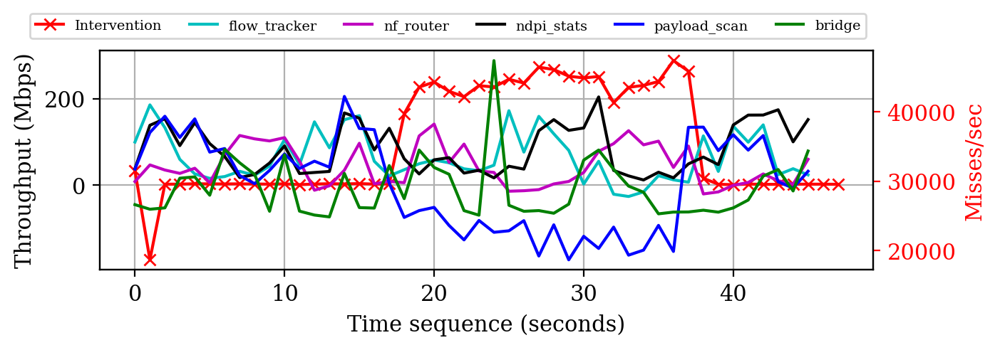

In [152]:
plot_feature_rs("L1-icache-load-misses", "Misses/sec",)

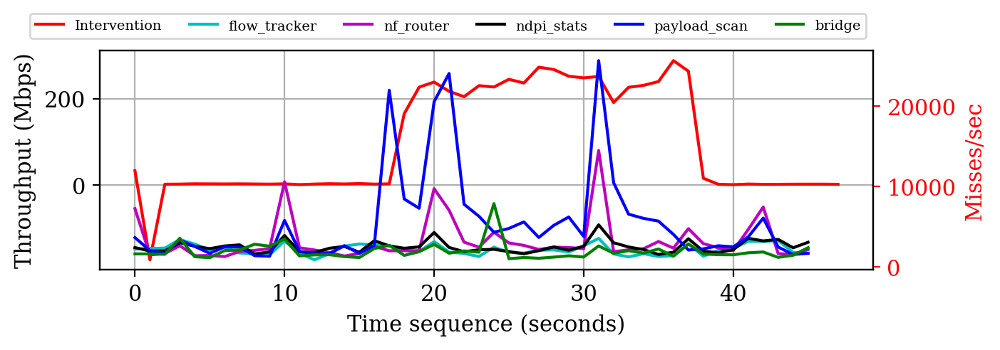

In [153]:
plot_feature_rs("LLC-load-misses", "Misses/sec",)

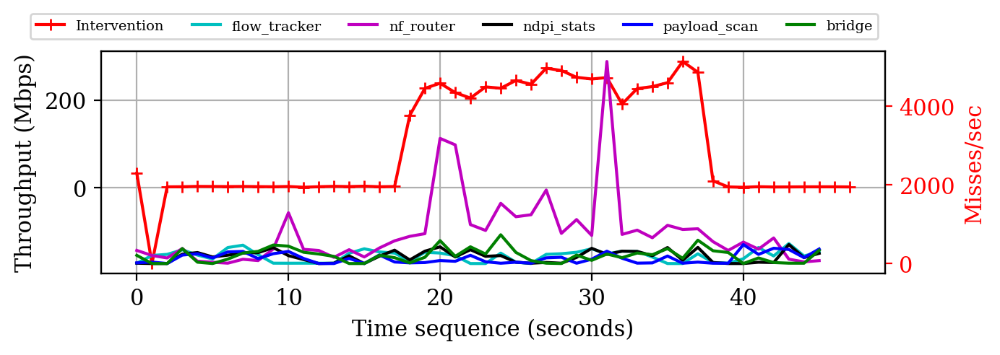

In [154]:
plot_feature_rs("LLC-store-misses", "Misses/sec",)

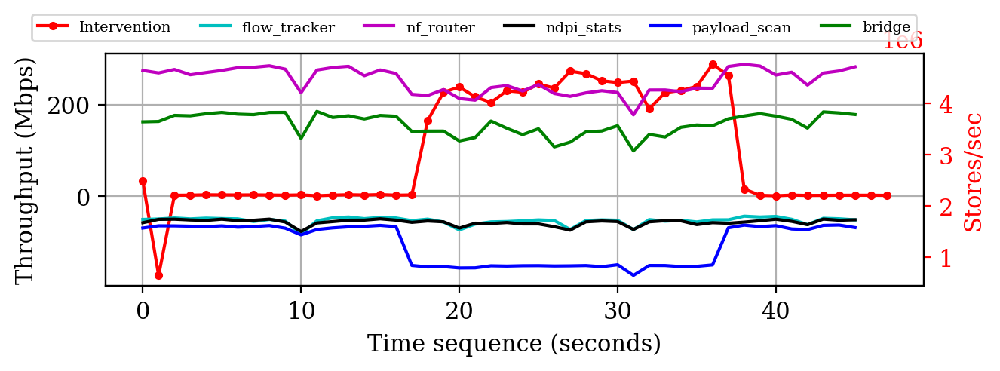

In [155]:
plot_feature_rs("LLC-stores", "Stores/sec",)

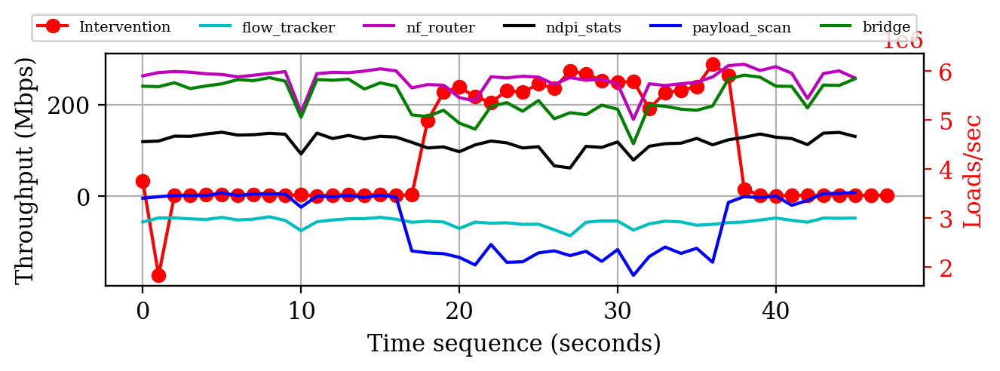

In [156]:
plot_feature_rs("LLC-loads", "Loads/sec",)

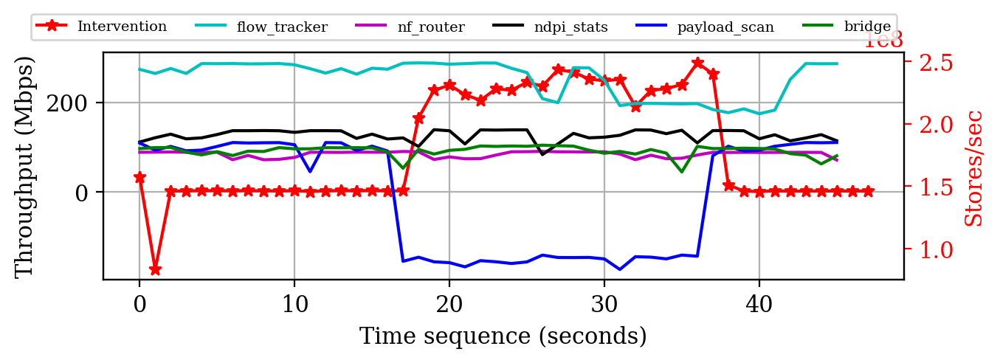

In [157]:
plot_feature_rs("dTLB-stores", "Stores/sec",)

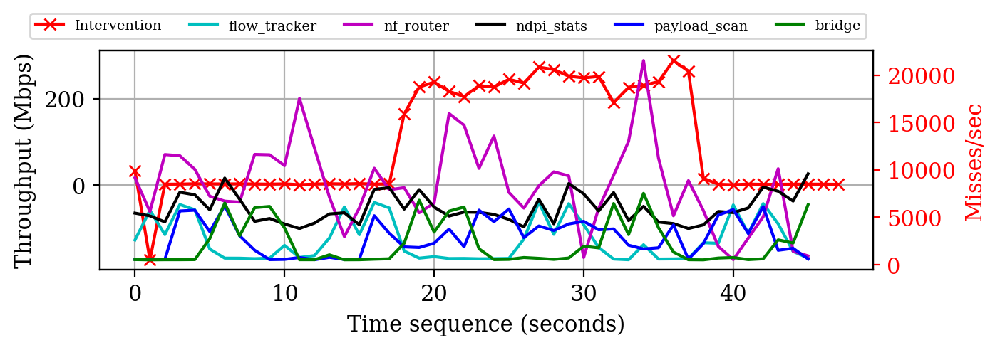

In [158]:
plot_feature_rs("dTLB-load-misses", "Misses/sec",)

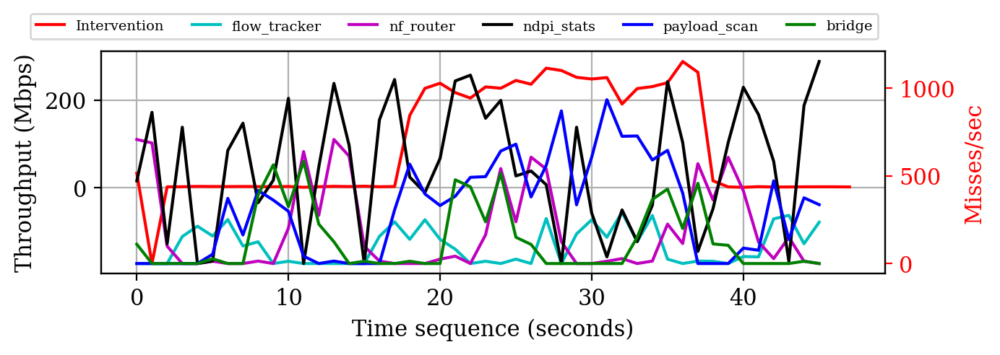

In [159]:
plot_feature_rs("dTLB-store-misses", "Misses/sec",)

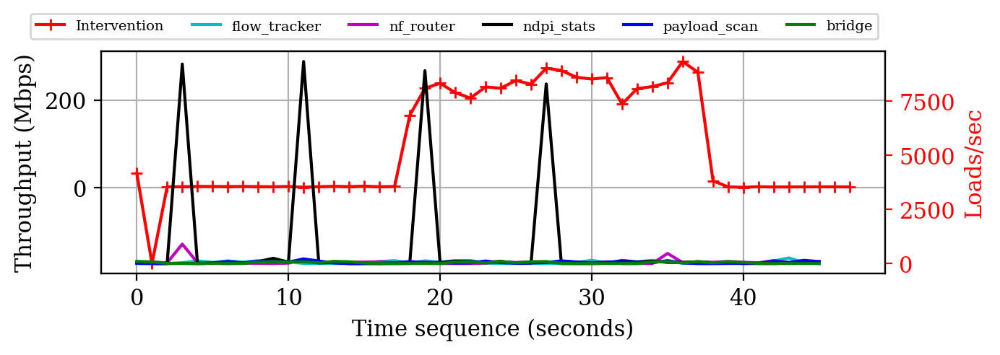

In [160]:
plot_feature_rs("iTLB-loads", "Loads/sec",)

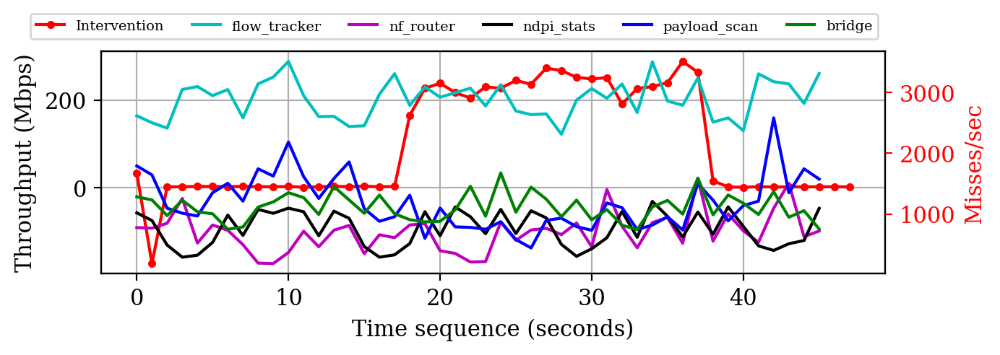

In [161]:
plot_feature_rs("iTLB-load-misses", "Misses/sec",)

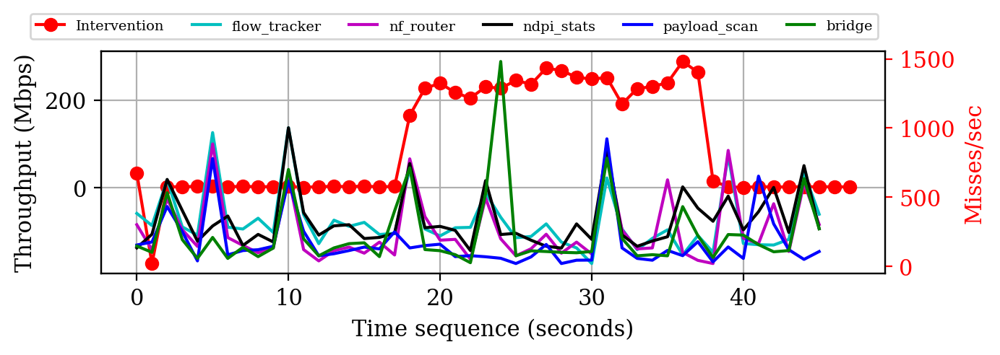

In [162]:
plot_feature_rs("node-load-misses", "Misses/sec",)

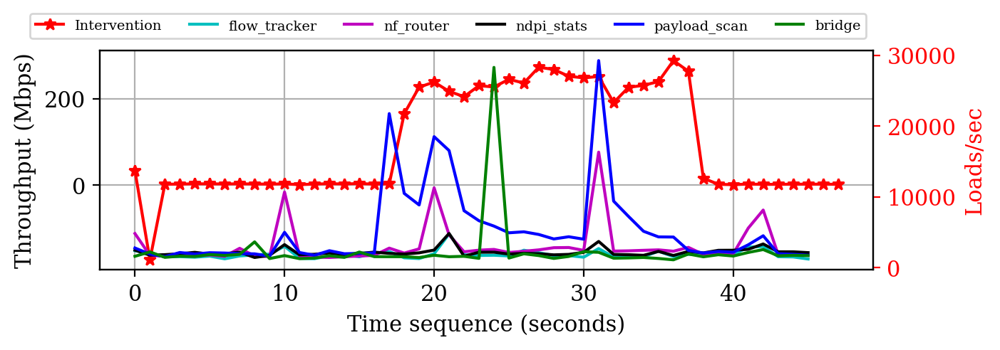

In [163]:
plot_feature_rs("node-loads", "Loads/sec",)

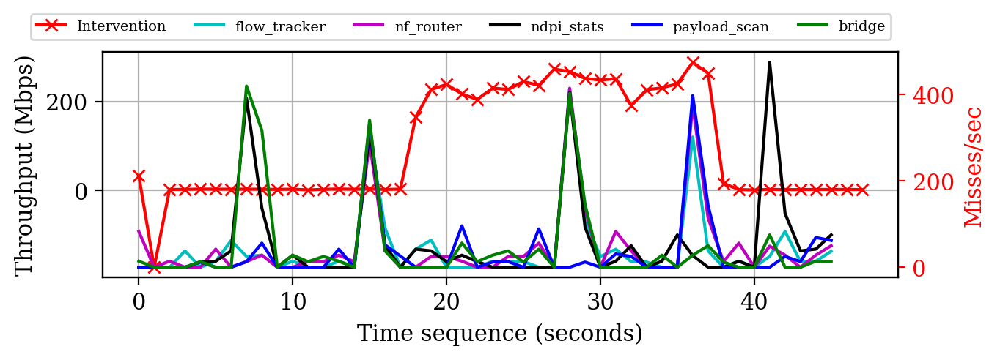

In [164]:
plot_feature_rs("node-store-misses", "Misses/sec",)

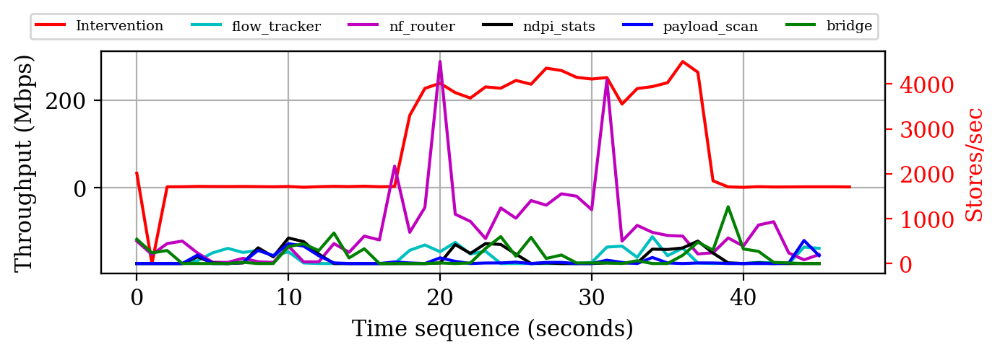

In [165]:
plot_feature_rs("node-stores", "Stores/sec",)

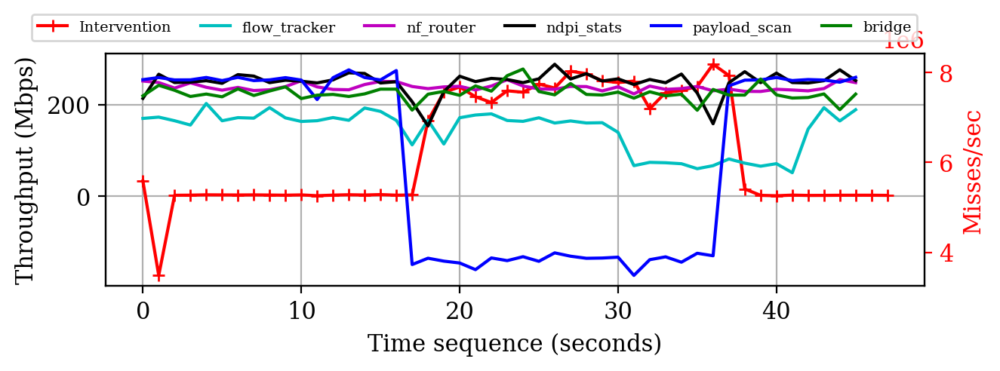

In [166]:
plot_feature_rs("branch-load-misses", "Misses/sec",)

### Stress-testing the Bridge

In [169]:
from IPython.display import IFrame
IFrame("../assets/case5.pdf", width=600, height=420)

In [170]:
exp_rs = "exp-7-1-5"

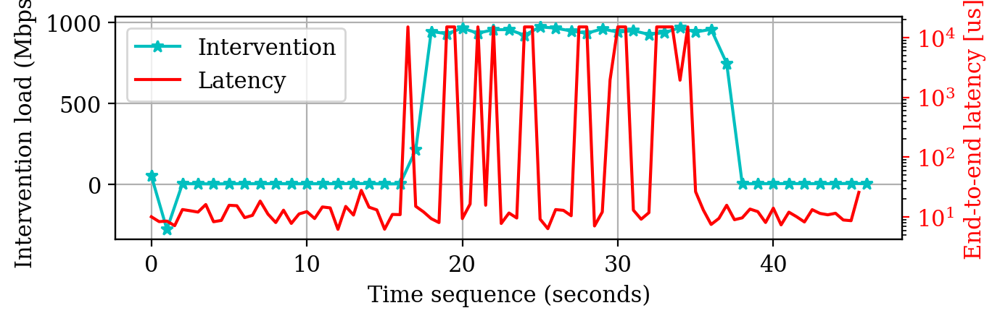

In [173]:
fig, ax = plt.subplots(figsize = (7,2))
ax.grid(True)
ax.set_xlabel("Time sequence (seconds)")
ax.set_ylabel("Intervention load (Mbps)")

ax2 = ax.twinx()
ax2.tick_params(axis='y', colors='red')
ax2.set_ylabel("End-to-end latency [us]", color="red")

tx = np.asarray(parse_seq("resource_stimulus", exp_rs, "tx_stats.csv"))
rx = np.asarray(parse_seq("resource_stimulus", exp_rs, "rx_stats.csv"))

diff = tx-rx

l = ax.plot(diff, marker=next(marker), color=next(cycol), label="Intervention")
lat = parse_seq("resource_stimulus", exp_rs, "latency.csv")
ax2.set_yscale("log")
l2 = ax2.plot(0.5*np.arange(0, len(lat)), lat, color="red", label="Latency")

lns = l+l2
labs = [l.get_label() for l in lns]
plt.legend(lns, labs)

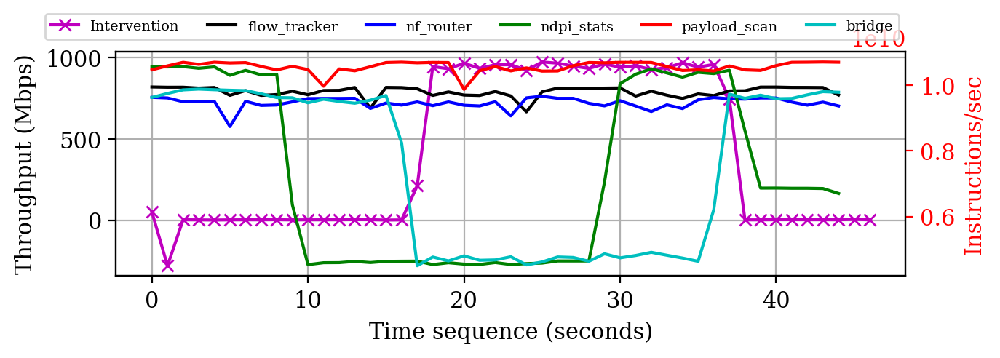

In [174]:
plot_feature_rs("instructions,", "Instructions/sec",)

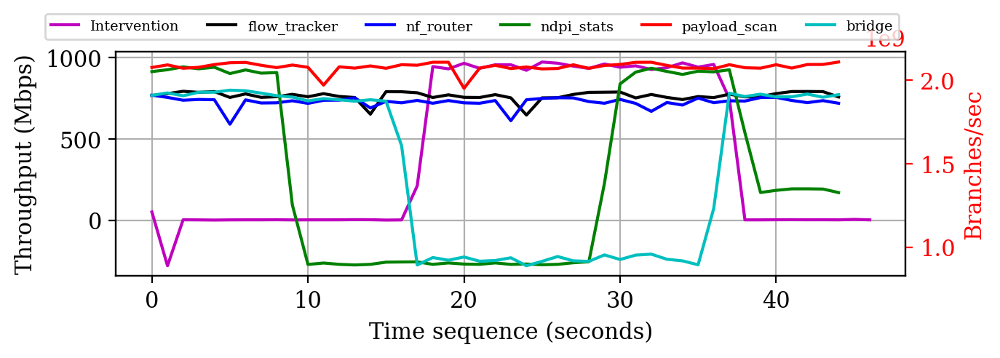

In [175]:
plot_feature_rs("branches,", "Branches/sec",)

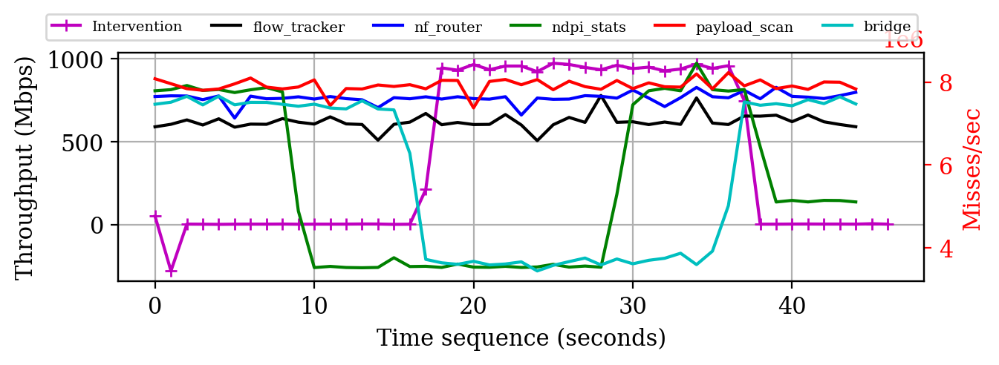

In [176]:
plot_feature_rs("branch-misses", "Misses/sec",)

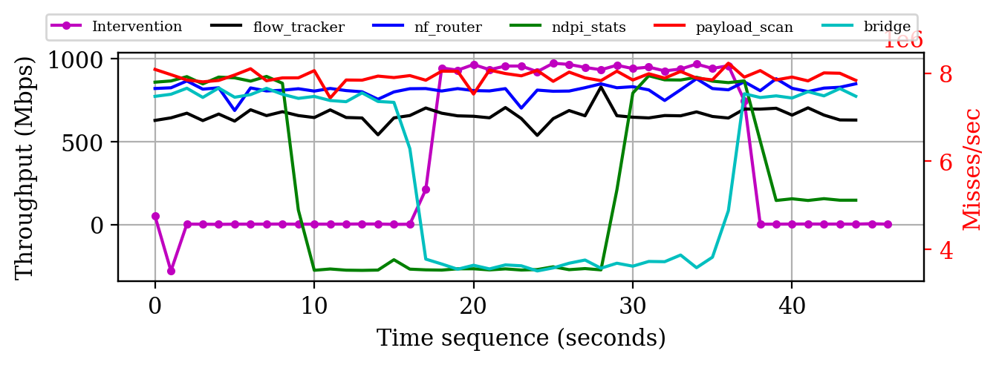

In [177]:
plot_feature_rs("branch-load-misses", "Misses/sec",)

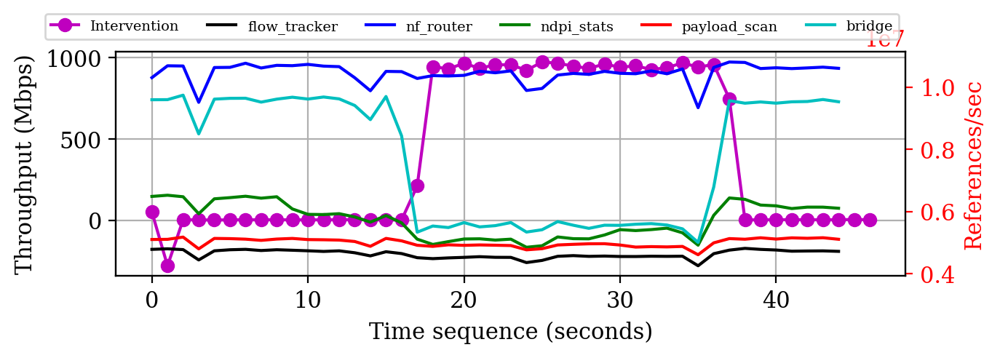

In [178]:
plot_feature_rs("cache-references", "References/sec",)

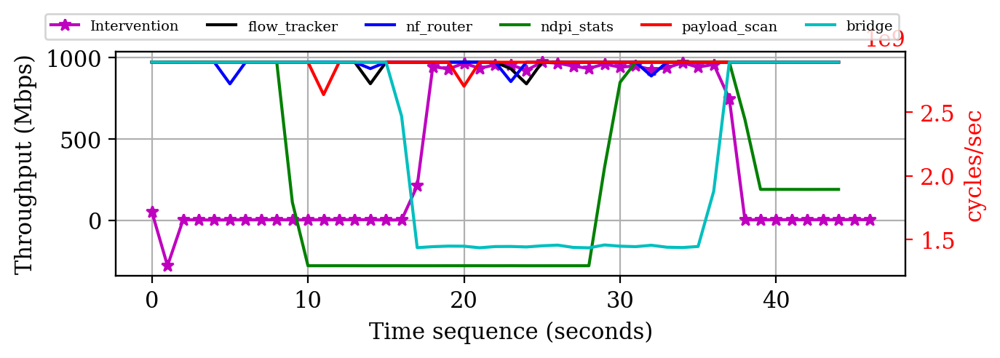

In [179]:
plot_feature_rs(",cycles,", "cycles/sec",)

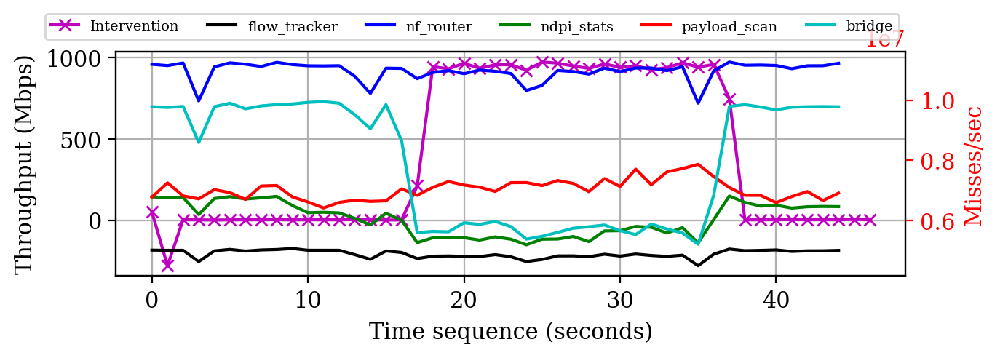

In [180]:
plot_feature_rs("L1-dcache-load-misses", "Misses/sec",)

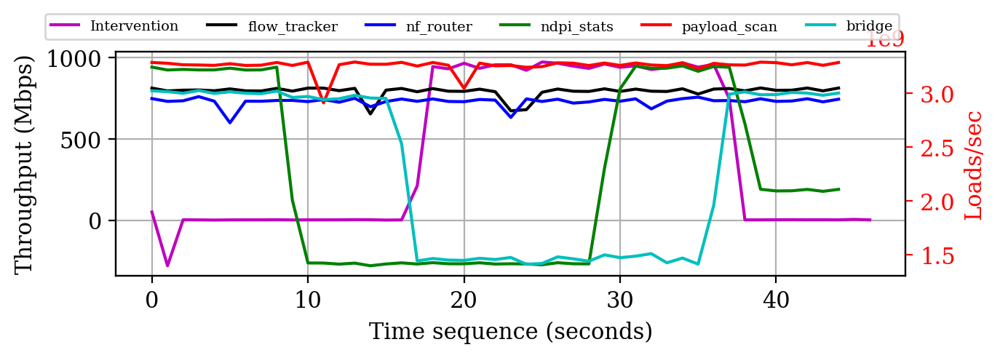

In [181]:
plot_feature_rs("L1-dcache-loads", "Loads/sec",)

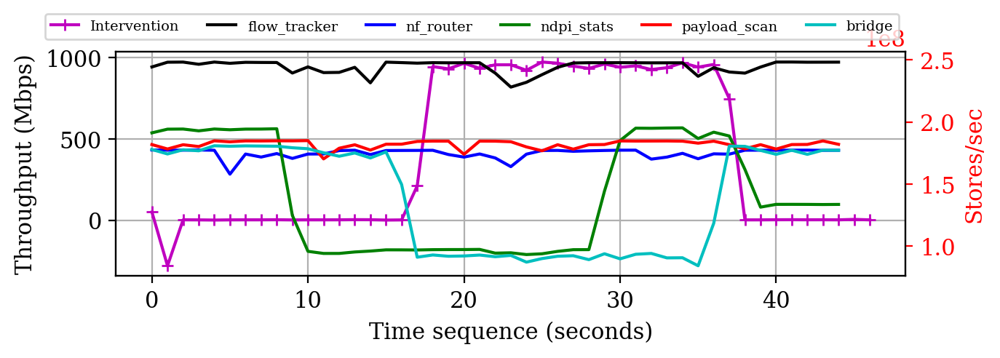

In [182]:
plot_feature_rs("L1-dcache-stores", "Stores/sec",)

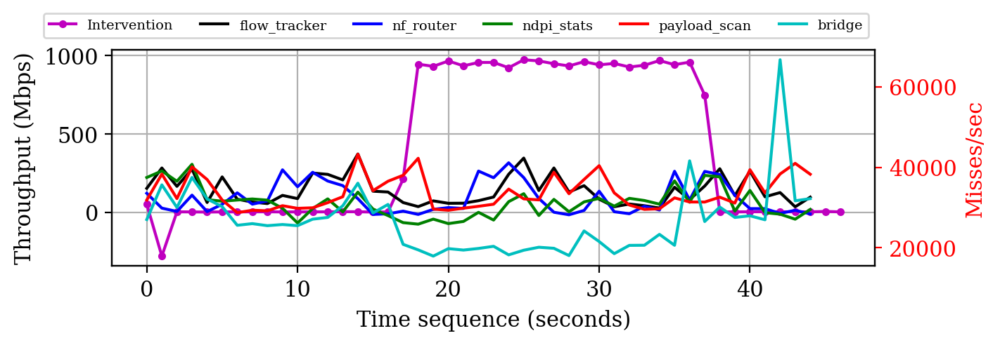

In [183]:
plot_feature_rs("L1-icache-load-misses", "Misses/sec",)

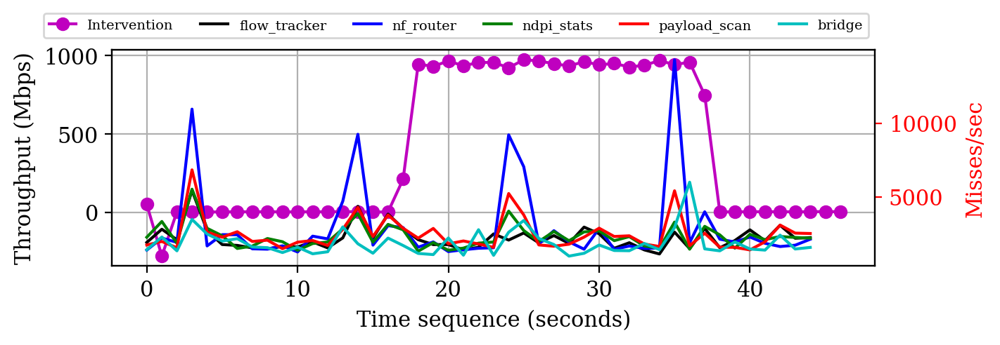

In [184]:
plot_feature_rs("LLC-load-misses", "Misses/sec",)

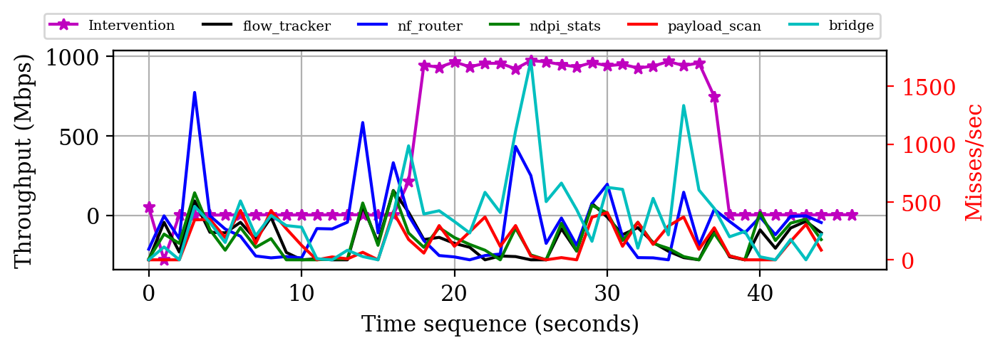

In [185]:
plot_feature_rs("LLC-store-misses", "Misses/sec",)

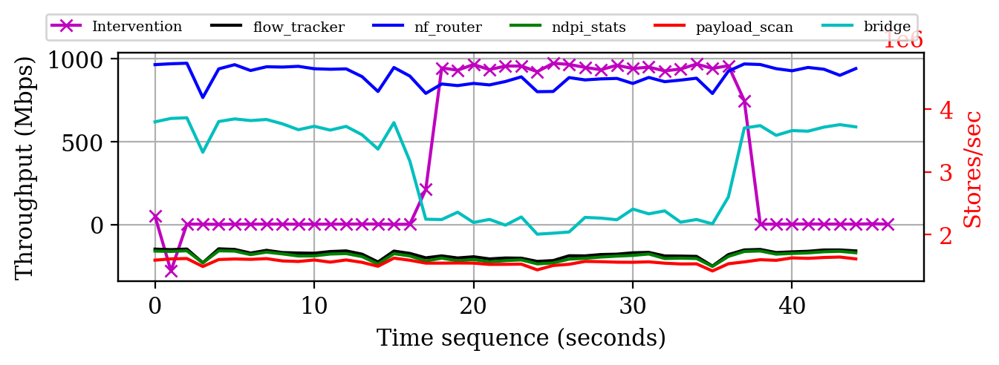

In [186]:
plot_feature_rs("LLC-stores", "Stores/sec",)

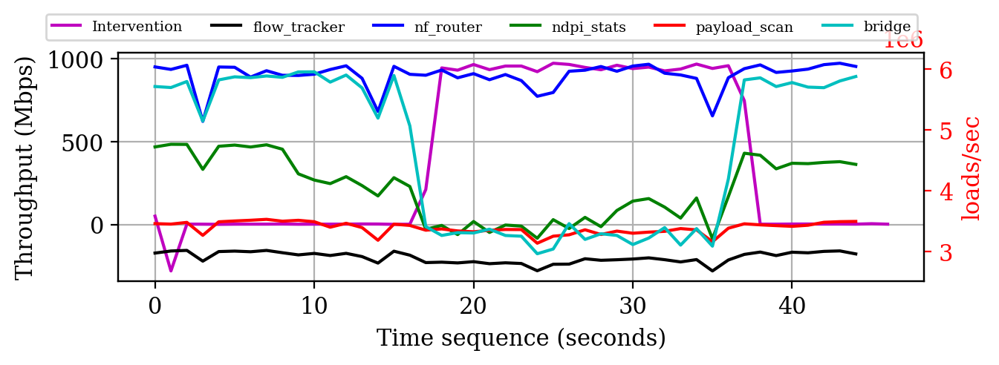

In [187]:
plot_feature_rs("LLC-loads", "loads/sec",)

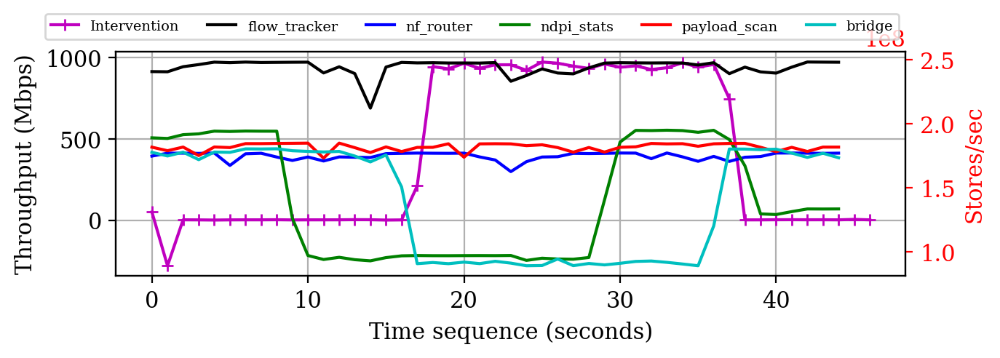

In [188]:
plot_feature_rs("dTLB-stores", "Stores/sec",)

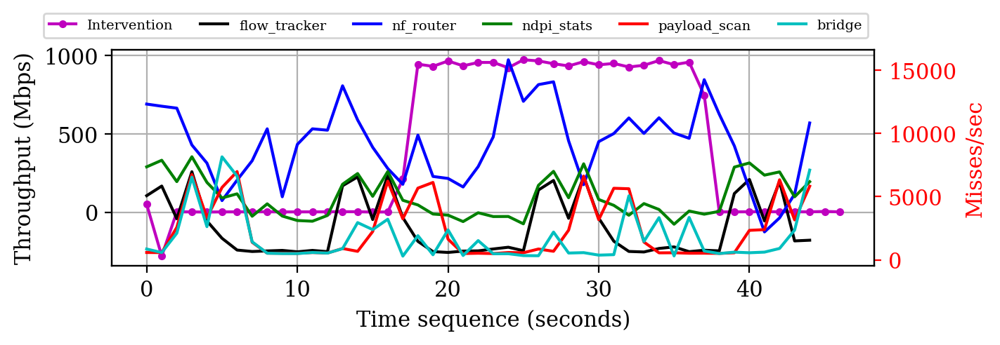

In [189]:
plot_feature_rs("dTLB-load-misses", "Misses/sec",)

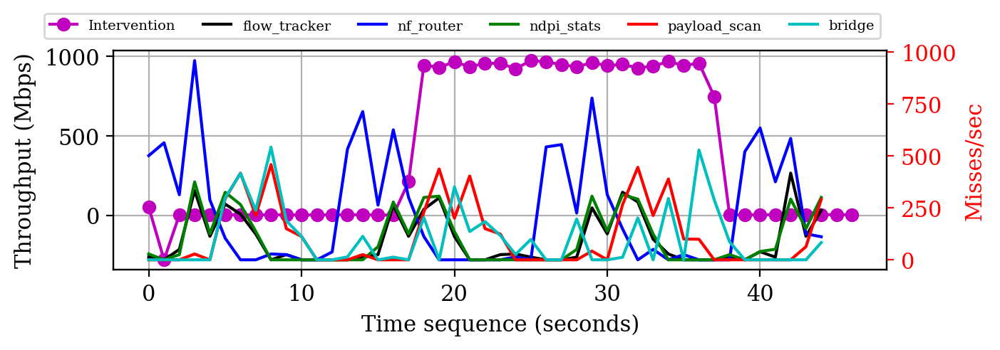

In [190]:
plot_feature_rs("dTLB-store-misses", "Misses/sec",)

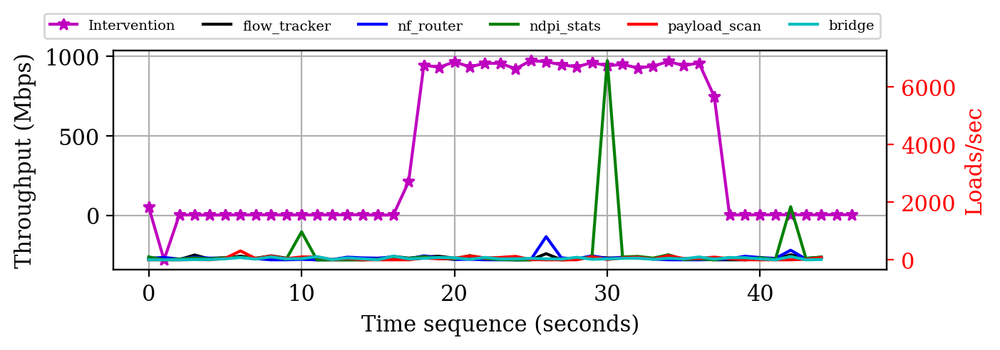

In [191]:
plot_feature_rs("iTLB-loads", "Loads/sec",)

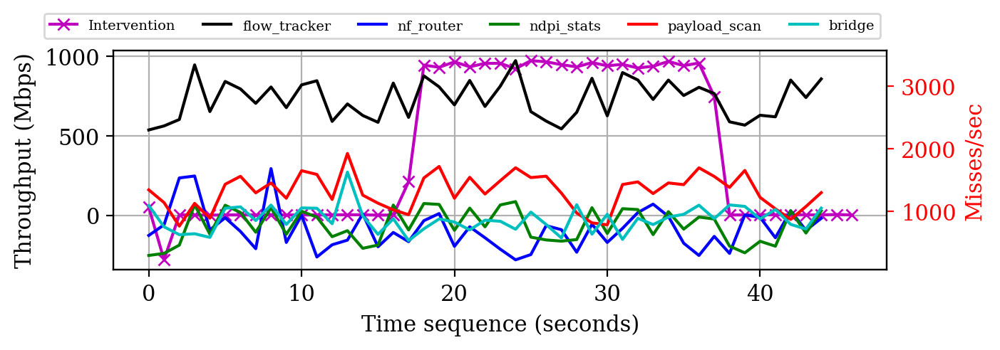

In [192]:
plot_feature_rs("iTLB-load-misses", "Misses/sec",)

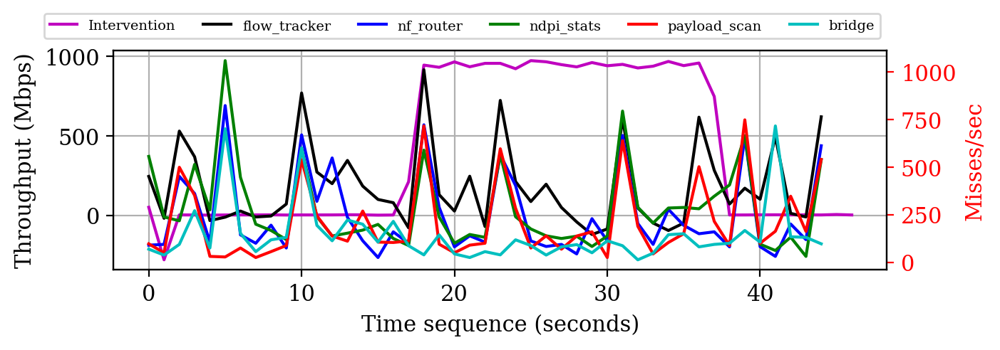

In [193]:
plot_feature_rs("node-load-misse", "Misses/sec",)

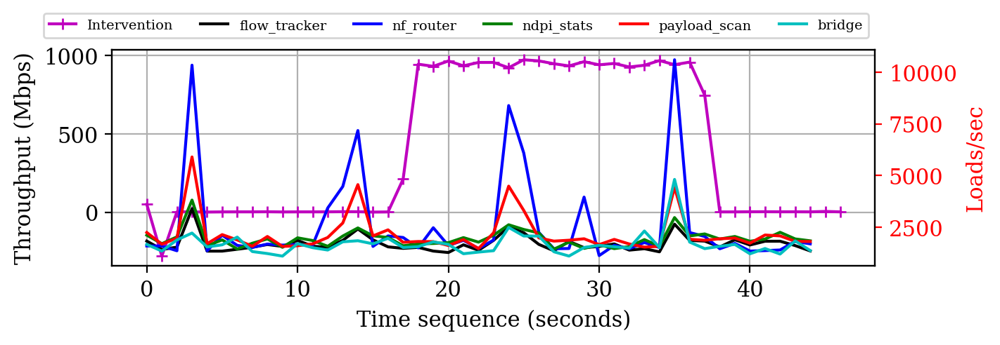

In [194]:
plot_feature_rs("node-loads", "Loads/sec",)

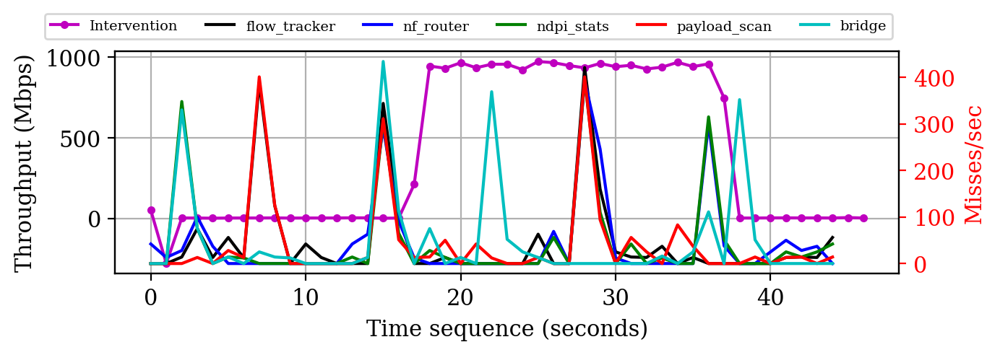

In [195]:
plot_feature_rs("node-store-misses", "Misses/sec",)

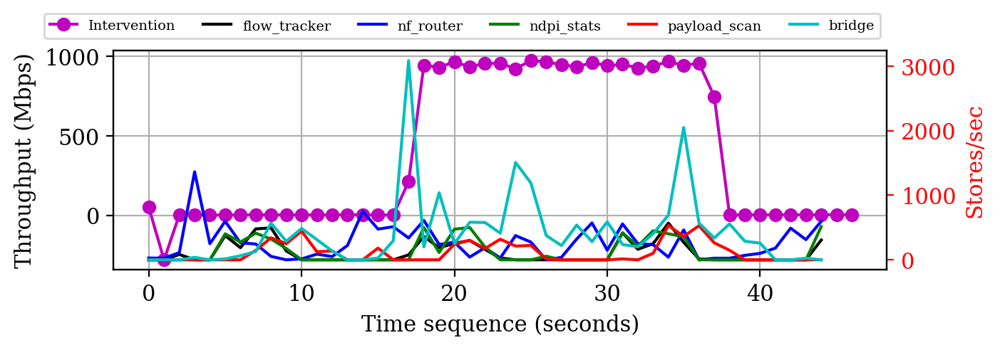

In [196]:
plot_feature_rs("node-stores", "Stores/sec",)